In [ ]:
import os
import sys
import time
import math
import tqdm
import imageio
import pathlib
import dataclasses
import collections
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.cm as cm
import cv2
import importlib

from datasets import load_dataset
from openpi.training import config as _config
from openpi.policies import policy_config
from openpi_client import image_tools

sys.path.append("/home/wyz/openpi/third_party/libero")
from libero.libero import benchmark, get_libero_path
from libero.libero.envs import OffScreenRenderEnv

os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["JAX_PLATFORMS"] = "cpu"
os.environ["TORCH_DISABLE_DYNAMO"] = "1"
os.environ["PYTORCH_JIT"] = "0"

# ✅ 强制重新加载 transformers 模块以确保使用最新的代码（包含 ToMe 修改）
print("🔄 Reloading transformers modules to ensure ToMe modifications are loaded...")
modules_to_reload = [
    'transformers.models.paligemma.modeling_paligemma',
    'transformers.models.siglip.modeling_siglip',
]

for module_name in modules_to_reload:
    if module_name in sys.modules:
        del sys.modules[module_name]
        print(f"  ✅ Cleared cache for {module_name}")

# 重新导入以确保使用最新代码
try:
    from transformers import PaliGemmaForConditionalGeneration
    print("  ✅ Successfully reloaded transformers modules")
except Exception as e:
    print(f"  ⚠️ Warning during reload: {e}")

LIBERO_DUMMY_ACTION = [0.0] * 6 + [-1.0]
LIBERO_ENV_RESOLUTION = 256


# ============================================================
# 📊 注意力热力图可视化工具
# ============================================================
# 全局变量存储注意力权重
_attention_weights_prefill = None
_attention_weights_decode = None

def attention_hook_prefill(module, input, output):
    """Hook 函数：捕获 Prefill 阶段的注意力权重"""
    global _attention_weights_prefill
    # GemmaAttention.forward 返回 (attn_output, attn_weights)
    # attn_weights 形状: [B, num_heads, seq_len, seq_len] 或 None
    if isinstance(output, tuple) and len(output) > 1:
        attn_weights = output[1]
        if attn_weights is not None and isinstance(attn_weights, torch.Tensor):
            _attention_weights_prefill = attn_weights
    elif hasattr(output, 'attentions') and output.attentions is not None:
        _attention_weights_prefill = output.attentions

def attention_hook_decode(module, input, output):
    """Hook 函数：捕获 Decode 阶段的注意力权重"""
    global _attention_weights_decode
    if isinstance(output, tuple) and len(output) > 1:
        if isinstance(output[1], torch.Tensor):
            _attention_weights_decode = output[1]
    elif hasattr(output, 'attentions') and output.attentions is not None:
        _attention_weights_decode = output.attentions

def extract_attention_from_llm_layer(
    model,
    vision_embeddings: torch.Tensor,
    text_embeddings: torch.Tensor,
    num_vision_tokens: int,
    layer_idx: int = 0,  # 使用第一层或最后一层
) -> torch.Tensor:
    """
    从 LLM 层提取文本对视觉的真实注意力权重
    
    Args:
        model: PaliGemma 模型
        vision_embeddings: [B, num_vision, D]
        text_embeddings: [B, num_text, D]
        num_vision_tokens: 视觉 token 数量
        layer_idx: 要提取的层索引
    
    Returns:
        attention: [B, num_vision] - 每个视觉 token 的注意力分数
    """
    global _attention_weights_prefill
    
    llm = model.paligemma_with_expert.paligemma.language_model
    
    # 拼接视觉和文本 embeddings
    all_embeddings = torch.cat([vision_embeddings, text_embeddings], dim=1)  # [B, num_vision+num_text, D]
    
    # 获取指定层
    if hasattr(llm, 'layers') and len(llm.layers) > layer_idx:
        target_layer = llm.layers[layer_idx]
        
        # 注册 hook 到注意力层
        if hasattr(target_layer, 'self_attn'):
            hook = target_layer.self_attn.register_forward_hook(attention_hook_prefill)
            
            # 前向传播（只到目标层）
            hidden_states = all_embeddings
            for i, layer in enumerate(llm.layers):
                if i <= layer_idx:
                    hidden_states = layer(hidden_states)[0] if isinstance(layer(hidden_states), tuple) else layer(hidden_states)
                else:
                    break
            
            # 移除 hook
            hook.remove()
            
            # 提取注意力权重
            if _attention_weights_prefill is not None:
                # _attention_weights_prefill 形状: [B, num_heads, seq_len, seq_len]
                attn_weights = _attention_weights_prefill
                
                # 如果是多 head，平均所有 head
                if attn_weights.ndim == 4:
                    attn_weights = attn_weights.mean(dim=1)  # [B, seq_len, seq_len]
                
                # 提取文本对视觉的注意力
                # attn_weights: [B, seq_len, seq_len]
                # 文本 token 位置: num_vision_tokens 到 seq_len
                # 视觉 token 位置: 0 到 num_vision_tokens
                text_to_vision_attn = attn_weights[:, num_vision_tokens:, :num_vision_tokens]  # [B, num_text, num_vision]
                
                # 聚合：平均所有文本 token 的注意力
                vision_attention = text_to_vision_attn.mean(dim=1)  # [B, num_vision]
                
                return vision_attention
    
    # Fallback: 使用余弦相似度
    vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)
    text_norm = F.normalize(text_embeddings, p=2, dim=-1)
    similarity = torch.bmm(vision_norm, text_norm.transpose(1, 2))
    attention = similarity.mean(dim=-1)  # 使用 mean 而不是 max，更平滑
    return attention


def extract_text_vision_attention(
    model,
    vision_embeddings: torch.Tensor,
    text_embeddings: torch.Tensor,
    num_vision_tokens: int,
    layer_idx: int = -1,  # 默认使用最后一层，通常最能体现任务焦点
    use_last_token_only: bool = True,  # 只使用最后一个文本token的注意力
) -> torch.Tensor:
    """
    从真实的Transformer层提取文本对视觉的注意力权重（Prefill阶段）
    
    改进：
    1. 从LLM层的真实attention weights提取，而不是使用余弦相似度
    2. 只取最后一个文本token的注意力（更能体现当前任务焦点）
    
    Args:
        model: PaliGemma模型
        vision_embeddings: [B, num_vision, D]
        text_embeddings: [B, num_text, D]
        num_vision_tokens: 视觉token数量
        layer_idx: 要提取的层索引（-1表示最后一层）
        use_last_token_only: 如果True，只使用最后一个文本token的注意力
    """
    global _attention_weights_prefill
    _attention_weights_prefill = None
    
    try:
        # 获取language_model：model可能是PaliGemmaWithExpertModel或PaliGemmaForConditionalGeneration
        if hasattr(model, 'paligemma'):
            # model是PaliGemmaWithExpertModel
            llm = model.paligemma.language_model
        elif hasattr(model, 'language_model'):
            # model是PaliGemmaForConditionalGeneration，直接有language_model属性
            llm = model.language_model
        elif hasattr(model, 'model') and hasattr(model.model, 'language_model'):
            # model是PaliGemmaForConditionalGeneration，通过model.language_model访问
            llm = model.model.language_model
        else:
            raise AttributeError(f"无法找到language_model，model类型: {type(model)}")
        
        # 拼接视觉和文本embeddings
        all_embeddings = torch.cat([vision_embeddings, text_embeddings], dim=1)  # [B, num_vision+num_text, D]
        
        # 确定层索引（-1表示最后一层）
        if layer_idx < 0:
            layer_idx = len(llm.layers) + layer_idx
        
        if hasattr(llm, 'layers') and len(llm.layers) > layer_idx:
            target_layer = llm.layers[layer_idx]
            
            # 注册hook到注意力层
            if hasattr(target_layer, 'self_attn'):
                hook = target_layer.self_attn.register_forward_hook(attention_hook_prefill)
                
                # 前向传播（只到目标层）
                hidden_states = all_embeddings
                for i, layer in enumerate(llm.layers):
                    if i <= layer_idx:
                        # 需要传递正确的参数
                        # GemmaDecoderLayer.forward 需要 output_attentions=True 来返回注意力权重
                        layer_output = layer(
                            hidden_states,
                            output_attentions=True if i == layer_idx else False,  # 只在目标层提取注意力
                            use_cache=False,
                        )
                        if isinstance(layer_output, tuple):
                            hidden_states = layer_output[0]
                        else:
                            hidden_states = layer_output
                    else:
                        break
                
                # 移除hook
                hook.remove()
                
                # 提取注意力权重
                if _attention_weights_prefill is not None:
                    attn_weights = _attention_weights_prefill
                    
                    # 如果是多head，平均所有head
                    if attn_weights.ndim == 4:
                        attn_weights = attn_weights.mean(dim=1)  # [B, seq_len, seq_len]
                    
                    # 提取文本对视觉的注意力
                    # attn_weights: [B, seq_len, seq_len]
                    # 文本token位置: num_vision_tokens 到 seq_len
                    # 视觉token位置: 0 到 num_vision_tokens
                    text_to_vision_attn = attn_weights[:, num_vision_tokens:, :num_vision_tokens]  # [B, num_text, num_vision]
                    
                    # 聚合：根据use_last_token_only决定使用最后一个token还是平均所有token
                    if use_last_token_only and text_to_vision_attn.shape[1] > 0:
                        # 只取最后一个文本token的注意力（更能体现当前任务焦点）
                        vision_attention = text_to_vision_attn[:, -1, :]  # [B, num_vision]
                    else:
                        # 平均所有文本token的注意力
                        vision_attention = text_to_vision_attn.mean(dim=1)  # [B, num_vision]
                    
                    return vision_attention
    except Exception as e:
        print(f"⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: {e}")
    
    # Fallback: 使用余弦相似度（如果从Transformer层提取失败）
    vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)  # [B, num_vision, D]
    text_norm = F.normalize(text_embeddings, p=2, dim=-1)  # [B, num_text, D]
    
    # 计算相似度矩阵: [B, num_vision, num_text]
    similarity = torch.bmm(vision_norm, text_norm.transpose(1, 2))
    
    # 聚合：如果use_last_token_only，只取最后一个token；否则平均
    if use_last_token_only and similarity.shape[-1] > 0:
        attention = similarity[:, :, -1]  # [B, num_vision] - 只取最后一个文本token
    else:
        attention = similarity.mean(dim=-1)  # [B, num_vision] - 平均所有文本token
    
    return attention


def reshape_attention_to_image(
    attention: torch.Tensor,
    image_size: tuple = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
    power_scale: float = 1.5,  # Power scale增强对比度（论文风格）
    use_nearest_interp: bool = True,  # 使用最近邻插值产生块状效果（论文风格）
) -> np.ndarray:
    """
    将注意力权重重塑为图像空间
    
    改进：
    1. 使用最近邻插值（INTER_NEAREST）产生块状效果，更接近论文风格
    2. 添加power scale归一化，增强对比度，使高亮区域更集中
    """
    if attention.ndim == 2:
        attention = attention[0]  # 取第一个 batch
    
    h, w = image_size
    h_patches = h // patch_size
    w_patches = w // patch_size
    patches_per_image = h_patches * w_patches
    
    # 处理多个图像
    if num_images > 1:
        attention = attention[:patches_per_image]
    
    if len(attention) > patches_per_image:
        attention = attention[:patches_per_image]
    elif len(attention) < patches_per_image:
        padding = patches_per_image - len(attention)
        attention = torch.cat([
            attention,
            torch.zeros(padding, device=attention.device)
        ])
    
    # 转换为 numpy 并重塑（确保 detach 和 no_grad）
    if isinstance(attention, torch.Tensor):
        # 先 detach，转换为 float32（bfloat16 不支持），再移动到 CPU，最后转换为 numpy
        attention = attention.detach().float().cpu().numpy()
    
    # 应用power scale增强对比度（在reshape之前）
    if power_scale != 1.0:
        # 归一化到[0, 1]范围
        attn_min = attention.min()
        attn_max = attention.max()
        if attn_max > attn_min:
            attention_norm = (attention - attn_min) / (attn_max - attn_min + 1e-8)
            # 应用power scale
            attention = attention_norm ** power_scale
            # 恢复原始范围
            attention = attention * (attn_max - attn_min) + attn_min
    
    attention_map = attention.reshape(h_patches, w_patches)
    
    # 上采样到原始图像大小
    # 使用最近邻插值产生块状效果（论文风格），而不是平滑的双线性插值
    interp_method = cv2.INTER_NEAREST if use_nearest_interp else cv2.INTER_LINEAR
    attention_map = cv2.resize(
        attention_map,
        (w, h),
        interpolation=interp_method
    )
    
    return attention_map


def visualize_attention_overlay(
    image: np.ndarray,
    attention_map: np.ndarray,
    title: str = "Attention",
    alpha: float = 0.6,
    cmap: str = 'jet',
    ax=None,
    use_percentile: bool = True,  # 使用百分位数归一化，使对比更明显
    power_scale: float = 1.0,  # 额外的power scale（在reshape之后再次应用）
):
    """
    在图像上叠加注意力热力图
    
    改进：
    1. 降低alpha值（0.4-0.5）减少背景干扰
    2. 支持额外的power scale增强对比度
    
    Args:
        use_percentile: 如果 True，使用百分位数归一化（去除极端值），使注意力更明显
        power_scale: 额外的power scale（在归一化之后应用），增强对比度
    """
    # 归一化注意力图
    if use_percentile:
        # 使用百分位数归一化，去除极端值，使注意力分布更明显
        p5 = np.percentile(attention_map, 5)
        p95 = np.percentile(attention_map, 95)
        attn_norm = (attention_map - p5) / (p95 - p5 + 1e-8)
        attn_norm = np.clip(attn_norm, 0, 1)
    else:
        attn_norm = (attention_map - attention_map.min()) / (attention_map.max() - attention_map.min() + 1e-8)
    
    # 应用额外的power scale增强对比度
    if power_scale != 1.0:
        attn_norm = attn_norm ** power_scale
    
    # 创建颜色映射（使用更鲜艳的颜色方案）
    colored_attention = plt.get_cmap(cmap)(attn_norm)[:, :, :3]
    
    # 叠加（调整混合方式，使注意力更突出）
    if image.dtype == np.uint8:
        image_norm = image.astype(np.float32) / 255.0
    else:
        image_norm = image.astype(np.float32)
    
    # 使用更明显的叠加方式
    overlay = (1 - alpha) * image_norm + alpha * colored_attention
    
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    
    ax.imshow(overlay)
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.axis('off')
    
    return ax


def visualize_prefill_decode_comparison(
    image: np.ndarray,
    prefill_attention: torch.Tensor,
    decode_attention: torch.Tensor,
    image_size: tuple = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
    alpha: float = 0.6,
    cmap: str = 'jet',
    save_path: str = None,
):
    """
    可视化 Prefill 和 Decode 阶段的注意力对比图（类似论文中的图）
    
    改进：
    - 使用最近邻插值产生块状效果（论文风格）
    - 使用power scale增强对比度
    - Prefill: 使用较低的 alpha (0.4-0.5)，使注意力更分散
    - Decode: 使用较低的 alpha (0.4-0.5)，但通过power scale使注意力更聚焦
    """
    # 重塑注意力到图像空间（使用最近邻插值和power scale）
    prefill_map = reshape_attention_to_image(
        prefill_attention, image_size, patch_size, num_images,
        power_scale=1.2,  # Prefill使用较小的power scale
        use_nearest_interp=True,  # 使用最近邻插值产生块状效果
    )
    decode_map = reshape_attention_to_image(
        decode_attention, image_size, patch_size, num_images,
        power_scale=1.5,  # Decode使用较大的power scale，使注意力更聚焦
        use_nearest_interp=True,  # 使用最近邻插值产生块状效果
    )
    
    # 创建并排对比图
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Prefill Attention - 更分散，使用较低的 alpha
    visualize_attention_overlay(
        image, prefill_map,
        title="(c) Prefill Attention",
        alpha=0.4,  # 降低alpha，减少背景干扰（论文风格）
        cmap=cmap,
        ax=axes[0],
        use_percentile=True,  # 使用百分位数归一化
        power_scale=1.0,  # 不再额外应用power scale
    )
    
    # Decode Attention - 更聚焦，使用较低的 alpha，但通过power scale增强对比度
    visualize_attention_overlay(
        image, decode_map,
        title="(d) Decode Attention",
        alpha=0.4,  # 降低alpha，减少背景干扰（论文风格）
        cmap=cmap,
        ax=axes[1],
        use_percentile=True,  # 使用百分位数归一化
        power_scale=1.0,  # 不再额外应用power scale（已在reshape中应用）
    )
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✅ 保存注意力对比图: {save_path}")
    else:
        plt.show()
    
    plt.close()


# ------------------------------------------------------------
# ✅ 加载策略
# ------------------------------------------------------------
def load_policy():
    print("Loading policy checkpoint ...")
    config = _config.get_config("pi05_libero")
    ckpt = "/home/wyz/openpi/checkpoints/pi05_libero_pytorch.pt"

    def _no_compile(x, *args, **kwargs):
        return x
    torch.compile = _no_compile

    try:
        torch.jit._state.disable()
    except Exception:
        pass

    policy = policy_config.create_trained_policy(config, ckpt, pytorch_device="cuda:0")
    print("✅ Policy loaded:", type(policy))
    if hasattr(policy, "model"):
        print(" → Using model:", policy.model.__class__.__module__)
    return policy


# ------------------------------------------------------------
# ✅ 工具函数
# ------------------------------------------------------------
def _quat2axisangle(quat):
    quat = np.array(quat)
    quat = np.clip(quat, -1.0, 1.0)
    den = np.sqrt(max(1e-6, 1.0 - quat[3] ** 2))
    if math.isclose(den, 0.0):
        return np.zeros(3)
    return (quat[:3] * 2.0 * math.acos(quat[3])) / den


def _get_libero_env(task, resolution, seed):
    task_desc = task.language
    bddl_path = pathlib.Path(get_libero_path("bddl_files")) / task.problem_folder / task.bddl_file
    env_args = {"bddl_file_name": bddl_path, "camera_heights": resolution, "camera_widths": resolution}
    env = OffScreenRenderEnv(**env_args)
    env.seed(seed)
    return env, task_desc


# ------------------------------------------------------------
# ✅ 参数类
# ------------------------------------------------------------
@dataclasses.dataclass
class Args:
    task_suite_name: str = "libero_spatial"
    num_trials_per_task: int = 1       # ✅ 每个任务只跑一次
    num_steps_wait: int = 10
    replan_steps: int = 5
    resize_size: int = 224
    video_out_path: str = "./libero_videos_prune"
    seed: int = 7
    # 注意力可视化相关参数
    visualize_attention: bool = True  # 是否可视化注意力
    attention_save_dir: str = "./attention_heatmaps"  # 注意力图保存目录
    attention_save_freq: int = 1  # 每 N 步保存一次注意力图（1=每步都保存）


# ------------------------------------------------------------
# ✅ 主评估函数
# ------------------------------------------------------------
def eval_libero_prune(args: Args):
    policy = load_policy()
    np.random.seed(args.seed)

    # ----------------------
    print("🔥 Warming up policy (compile + autotune)...")
    dummy_element = {
        "observation/image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/wrist_image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/state": np.zeros(8, dtype=np.float32),
        "prompt": "dummy task",
    }
    with torch.inference_mode():
        _ = policy.infer(dummy_element)
    torch.cuda.synchronize()
    print("✅ Warmup done, start evaluation...\n")

    # ----------------------
    benchmark_dict = benchmark.get_benchmark_dict()
    task_suite = benchmark_dict[args.task_suite_name]()
    num_tasks = task_suite.n_tasks

    pathlib.Path(args.video_out_path).mkdir(parents=True, exist_ok=True)
    
    # 创建注意力图保存目录
    if args.visualize_attention:
        pathlib.Path(args.attention_save_dir).mkdir(parents=True, exist_ok=True)
        print(f"📊 注意力可视化已启用，保存目录: {args.attention_save_dir}")

    # 最大步数设定
    if args.task_suite_name == "libero_spatial":
        max_steps = 220
    elif args.task_suite_name == "libero_object":
        max_steps = 280
    elif args.task_suite_name == "libero_goal":
        max_steps = 300
    else:
        max_steps = 400

    total_episodes, total_successes = 0, 0
    total_infer_times = []

    print(f"\n🔹 Running evaluation on suite: {args.task_suite_name} ({num_tasks} tasks)")

    for task_id in tqdm.tqdm(range(num_tasks), desc="Tasks"):
        task = task_suite.get_task(task_id)
        init_states = task_suite.get_task_init_states(task_id)
        init_states = init_states[:args.num_trials_per_task]

        env, desc = _get_libero_env(task, LIBERO_ENV_RESOLUTION, args.seed)
        task_episodes, task_successes = 0, 0
        task_infer_times = []

        for ep in range(args.num_trials_per_task):
            obs = env.set_init_state(init_states[ep])
            env.reset()
            action_plan = collections.deque()
            replay_imgs = []

            # 环境稳定等待
            for _ in range(args.num_steps_wait):
                obs, _, _, _ = env.step(LIBERO_DUMMY_ACTION)

            done = False
            t = 0
            while t < max_steps + args.num_steps_wait:
                try:
                    img = np.ascontiguousarray(obs["agentview_image"][::-1, ::-1])
                    wrist = np.ascontiguousarray(obs["robot0_eye_in_hand_image"][::-1, ::-1])

                    img = image_tools.convert_to_uint8(image_tools.resize_with_pad(img, args.resize_size, args.resize_size))
                    wrist = image_tools.convert_to_uint8(image_tools.resize_with_pad(wrist, args.resize_size, args.resize_size))
                    replay_imgs.append(img)

                    if not action_plan:
                        element = {
                            "observation/image": img,
                            "observation/wrist_image": wrist,
                            "observation/state": np.concatenate(
                                (obs["robot0_eef_pos"], _quat2axisangle(obs["robot0_eef_quat"]), obs["robot0_gripper_qpos"])
                            ),
                            "prompt": str(desc),
                        }

                        # ✅ 提取注意力（在推理之前）
                        prefill_attention = None
                        decode_attention = None
                        if args.visualize_attention and t % args.attention_save_freq == 0:
                            try:
                                # 正确获取模型对象：Policy 使用 _model 属性
                                model = policy._model if hasattr(policy, '_model') else policy
                                
                                # 获取设备：对于 PyTorch 模型，使用 _pytorch_device
                                if hasattr(policy, '_pytorch_device'):
                                    device = torch.device(policy._pytorch_device)
                                elif hasattr(model, 'parameters'):
                                    device = next(model.parameters()).device
                                else:
                                    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
                                
                                # 预处理图像（先移动到设备，再进行操作）
                                img_tensor = torch.from_numpy(img).permute(2, 0, 1).float() / 255.0
                                wrist_tensor = torch.from_numpy(wrist).permute(2, 0, 1).float() / 255.0
                                
                                # 先移动到设备
                                img_tensor = img_tensor.unsqueeze(0).to(device)
                                wrist_tensor = wrist_tensor.unsqueeze(0).to(device)
                                
                                # Resize（在设备上进行）
                                img_tensor = F.interpolate(img_tensor, size=(args.resize_size, args.resize_size), mode='bilinear', align_corners=False)
                                wrist_tensor = F.interpolate(wrist_tensor, size=(args.resize_size, args.resize_size), mode='bilinear', align_corners=False)
                                
                                # SigLIP 归一化（确保 mean 和 std 在同一个设备上）
                                mean = torch.tensor([0.5, 0.5, 0.5], device=device).view(1, 3, 1, 1)
                                std = torch.tensor([0.5, 0.5, 0.5], device=device).view(1, 3, 1, 1)
                                img_tensor = (img_tensor - mean) / std
                                wrist_tensor = (wrist_tensor - mean) / std
                                
                                # 获取实际的模型对象（可能是PaliGemmaWithExpertModel或包含它的对象）
                                if hasattr(model, 'paligemma_with_expert'):
                                    actual_model = model.paligemma_with_expert
                                else:
                                    # model可能已经是PaliGemmaWithExpertModel
                                    actual_model = model
                                
                                # 嵌入图像（只使用主视角图像用于可视化）
                                img_emb = actual_model.embed_image(img_tensor)
                                
                                # 只使用主视角图像的 embeddings 用于可视化
                                vision_embeddings = img_emb  # [B, num_vision, D]
                                
                                # 嵌入文本
                                # 使用 tokenizer 编码 prompt
                                from openpi.models.tokenizer import PaligemmaTokenizer
                                tokenizer = PaligemmaTokenizer(max_len=48)
                                tokens, mask = tokenizer.tokenize(str(desc), state=None)
                                tokens = torch.from_numpy(tokens).unsqueeze(0).to(device)
                                
                                lang_emb = actual_model.embed_language_tokens(tokens)
                                lang_emb_dim = lang_emb.shape[-1]
                                text_embeddings = lang_emb * math.sqrt(lang_emb_dim)  # [B, num_text, D]
                                
                                # 提取 Prefill 和 Decode 注意力（从真实的Transformer层提取）
                                # 使用 no_grad 确保不需要梯度
                                with torch.no_grad():
                                    num_vision_tokens = vision_embeddings.shape[1]
                                    
                                    # Prefill: 从Transformer层提取文本对视觉的真实注意力权重
                                    # 使用最后一层（layer_idx=-1），只取最后一个文本token的注意力（use_last_token_only=True）
                                    prefill_attention = extract_text_vision_attention(
                                        actual_model,
                                        vision_embeddings,
                                        text_embeddings,
                                        num_vision_tokens,
                                        layer_idx=-1,  # 使用最后一层，最能体现任务焦点
                                        use_last_token_only=False,  # Prefill使用所有文本token的平均
                                    )  # [B, num_vision]
                                    
                                    # Decode: 只使用最后一个文本token的注意力（更能体现当前任务焦点）
                                    decode_attention = extract_text_vision_attention(
                                        actual_model,
                                        vision_embeddings,
                                        text_embeddings,
                                        num_vision_tokens,
                                        layer_idx=-1,  # 使用最后一层
                                        use_last_token_only=True,  # Decode只使用最后一个文本token
                                    )  # [B, num_vision]
                                    
                                    # 确保 detach（双重保险）
                                    prefill_attention = prefill_attention.detach()
                                    decode_attention = decode_attention.detach()
                                    
                                    # 不再应用softmax，因为真实的attention weights已经是softmax后的概率分布
                                    # 如果需要增强对比度，会在reshape_attention_to_image中通过power_scale实现
                                
                            except Exception as e:
                                print(f"⚠️ 提取注意力时出错: {e}")
                                import traceback
                                traceback.print_exc()

                        # ✅ 纯推理时间测量
                        with torch.inference_mode():
                            torch.cuda.synchronize()
                            t0 = time.perf_counter()
                            actions = policy.infer(element)["actions"]
                            torch.cuda.synchronize()
                            infer_time = (time.perf_counter() - t0) * 1000
                            task_infer_times.append(infer_time)

                        # ✅ 保存注意力热力图
                        if args.visualize_attention and prefill_attention is not None and decode_attention is not None:
                            try:
                                seg = desc.replace(" ", "_")
                                save_path = pathlib.Path(args.attention_save_dir) / f"task{task_id}_ep{ep}_step{t}_attention.png"
                                
                                # 只可视化主视角图像（agentview）
                                visualize_prefill_decode_comparison(
                                    image=img,
                                    prefill_attention=prefill_attention,
                                    decode_attention=decode_attention,
                                    image_size=(args.resize_size, args.resize_size),
                                    patch_size=16,
                                    num_images=1,  # 只显示第一个图像（agentview）
                                    alpha=0.6,
                                    cmap='jet',
                                    save_path=str(save_path)
                                )
                            except Exception as e:
                                print(f"⚠️ 保存注意力图时出错: {e}")

                        action_plan.extend(actions[: args.replan_steps])

                    action = action_plan.popleft()
                    obs, reward, done, info = env.step(action.tolist())

                    if done:
                        task_successes += 1
                        total_successes += 1
                        break

                    t += 1

                except Exception as e:
                    print(f"[⚠️] Exception in task {task_id}, ep {ep}: {e}")
                    break

            task_episodes += 1
            total_episodes += 1

            tag = "success" if done else "failure"
            seg = desc.replace(" ", "_")
            imageio.mimwrite(
                pathlib.Path(args.video_out_path) / f"rollout_{seg}_{tag}_ep{ep}.mp4",
                [np.asarray(x) for x in replay_imgs],
                fps=10,
            )

        # ===== 每个任务结果 =====
        sr = 100 * task_successes / max(task_episodes, 1)
        total_sr = 100 * total_successes / max(total_episodes, 1)
        avg_infer = np.mean(task_infer_times)
        total_infer_times.extend(task_infer_times)

        print(f"✅ Task {task_id}: {desc}")
        print(f" Success rate: {task_successes}/{task_episodes} = {sr:.1f}%")
        print(f" Avg inference time: {avg_infer:.2f} ms")
        print(f" Overall success: {total_successes}/{total_episodes} = {total_sr:.1f}%\n")

    # ===== 汇总结果 =====
    print("=" * 60)
    print(f"🎯 Final success rate on {args.task_suite_name}: {total_successes}/{total_episodes} = {(100 * total_successes / total_episodes):.2f}%")
    print(f"⚙️ Avg inference time over all tasks: {np.mean(total_infer_times):.2f} ± {np.std(total_infer_times):.2f} ms")
    print("=" * 60)


# ------------------------------------------------------------
# ✅ 运行入口
# ------------------------------------------------------------
if __name__ == "__main__":
    args = Args(task_suite_name="libero_spatial", num_trials_per_task=50)  # ✅ 每个任务只跑一次
    with torch.autocast(device_type='cuda', dtype=torch.bfloat16):
        eval_libero_prune(args)


🔄 Reloading transformers modules to ensure ToMe modifications are loaded...
  ✅ Cleared cache for transformers.models.siglip.modeling_siglip
  ✅ Successfully reloaded transformers modules
Loading policy checkpoint ...
[ToMe Debug] SiglipVisionTransformer.__init__ called
[ToMe Debug] config type: <class 'transformers.models.siglip.configuration_siglip.SiglipVisionConfig'>
[ToMe Debug] hasattr(config, 'tome_enabled'): True
[ToMe Debug] config.tome_enabled = True
[ToMe Debug] config.tome_ratio = 0.75
[ToMe] ✅ Enabled in ViT: target_ratio=0.750, per_application_ratio=0.931, layers=2-5 (layer_idx 1-4), num_layers=27, num_applications=4, _TOME_AVAILABLE=True
✅ Policy loaded: <class 'openpi.policies.policy.Policy'>
🔥 Warming up policy (compile + autotune)...
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931

Tasks:   0%|          | 0/10 [00:00<?, ?it/s]

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.

Tasks:  10%|█         | 1/10 [04:30<40:32, 270.29s/it]

✅ Task 0: pick up the black bowl between the plate and the ramekin and place it on the plate
 Success rate: 42/50 = 84.0%
 Avg inference time: 117.77 ms
 Overall success: 42/50 = 84.0%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[T

Tasks:  20%|██        | 2/10 [10:26<42:47, 320.93s/it]

✅ Task 1: pick up the black bowl next to the ramekin and place it on the plate
 Success rate: 31/50 = 62.0%
 Avg inference time: 118.34 ms
 Overall success: 73/100 = 73.0%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3:

Tasks:  30%|███       | 3/10 [14:45<34:07, 292.52s/it]

✅ Task 2: pick up the black bowl from table center and place it on the plate
 Success rate: 50/50 = 100.0%
 Avg inference time: 117.74 ms
 Overall success: 123/150 = 82.0%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3:

Tasks:  40%|████      | 4/10 [20:01<30:11, 301.92s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.89 ms
  Text Embed             : 0.11 ms
  LLM (total)            : 81.75 ms
    ├─ prefix (KV cache): 28.53 ms
    └─ flow matching    : 53.22 ms (avg 5.32 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 96.94 ms

✅ Task 3: pick up the black bowl on the cookie box and place it on the plate
 Success rate: 35/50 = 70.0%
 Avg inference time: 118.38 ms
 Overall success: 158/200 = 79.0%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduc

Tasks:  50%|█████     | 5/10 [26:46<28:15, 339.16s/it]

✅ Task 4: pick up the black bowl in the top drawer of the wooden cabinet and place it on the plate
 Success rate: 28/50 = 56.0%
 Avg inference time: 118.96 ms
 Overall success: 186/250 = 74.4%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=7.0%)
[ToMe] Layer 3: 238 -> 221 tokens (ratio=0.931, reduction=7.1%)
[ToMe] Layer 4: 221 -> 205 tokens (ratio=0.931, reduction=7.2%)
[ToMe] Layer 5: 205 -> 190 tokens (ratio=0.931, reduction=7.3%)
[ToMe] Layer 2: 256 -> 238 tokens (ratio=0.931, reduction=

In [2]:
# ============================================================
# 📊 Prefill & Decode Attention 可视化工具
# ============================================================
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import cv2
from typing import Optional, Tuple

def extract_text_vision_attention(
    model,
    vision_embeddings: torch.Tensor,
    text_embeddings: torch.Tensor,
) -> torch.Tensor:
    """
    提取文本对视觉的注意力（Prefill 阶段）
    
    Args:
        model: PaliGemma 模型
        vision_embeddings: [B, num_vision, D]
        text_embeddings: [B, num_text, D]
    
    Returns:
        attention: [B, num_vision] - 每个视觉 token 的注意力分数
    """
    # 使用余弦相似度计算文本对视觉的注意力
    vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)  # [B, num_vision, D]
    text_norm = F.normalize(text_embeddings, p=2, dim=-1)  # [B, num_text, D]
    
    # 计算相似度矩阵: [B, num_vision, num_text]
    similarity = torch.bmm(vision_norm, text_norm.transpose(1, 2))
    
    # 聚合：取每个视觉 token 与所有文本 token 的最大相似度
    attention = similarity.max(dim=-1)[0]  # [B, num_vision]
    
    return attention


def reshape_attention_to_image(
    attention: torch.Tensor,
    image_size: Tuple[int, int] = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
) -> np.ndarray:
    """
    将注意力权重重塑为图像空间
    """
    if attention.ndim == 2:
        attention = attention[0]  # 取第一个 batch
    
    h, w = image_size
    h_patches = h // patch_size
    w_patches = w // patch_size
    patches_per_image = h_patches * w_patches
    
    # 处理多个图像
    if num_images > 1:
        attention = attention[:patches_per_image]
    
    if len(attention) > patches_per_image:
        attention = attention[:patches_per_image]
    elif len(attention) < patches_per_image:
        padding = patches_per_image - len(attention)
        attention = torch.cat([
            attention,
            torch.zeros(padding, device=attention.device)
        ])
    
    # 转换为 numpy 并重塑
    if isinstance(attention, torch.Tensor):
        attention = attention.cpu().numpy()
    
    attention_map = attention.reshape(h_patches, w_patches)
    
    # 上采样到原始图像大小
    attention_map = cv2.resize(
        attention_map,
        (w, h),
        interpolation=cv2.INTER_LINEAR
    )
    
    return attention_map


def visualize_attention_overlay(
    image: np.ndarray,
    attention_map: np.ndarray,
    title: str = "Attention",
    alpha: float = 0.6,
    cmap: str = 'jet',
    ax=None,
):
    """
    在图像上叠加注意力热力图
    """
    # 归一化注意力图
    attn_norm = (attention_map - attention_map.min()) / (attention_map.max() - attention_map.min() + 1e-8)
    
    # 创建颜色映射
    colored_attention = plt.get_cmap(cmap)(attn_norm)[:, :, :3]
    
    # 叠加
    if image.dtype == np.uint8:
        image_norm = image / 255.0
    else:
        image_norm = image
    
    overlay = (1 - alpha) * image_norm + alpha * colored_attention
    
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    
    ax.imshow(overlay)
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.axis('off')
    
    return ax


def visualize_prefill_decode_comparison(
    image: np.ndarray,
    prefill_attention: torch.Tensor,
    decode_attention: torch.Tensor,
    image_size: Tuple[int, int] = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
    alpha: float = 0.6,
    cmap: str = 'jet',
    save_path: Optional[str] = None,
):
    """
    可视化 Prefill 和 Decode 阶段的注意力对比图（类似论文中的图）
    
    Args:
        image: 原始图像 (H, W, C)
        prefill_attention: Prefill 注意力 [B, num_vision] 或 [num_vision]
        decode_attention: Decode 注意力 [B, num_vision] 或 [num_vision]
        image_size: 图像大小
        patch_size: patch 大小
        num_images: 图像数量
        alpha: 叠加透明度
        cmap: 颜色映射
        save_path: 保存路径
    """
    # 重塑注意力到图像空间
    prefill_map = reshape_attention_to_image(
        prefill_attention, image_size, patch_size, num_images
    )
    decode_map = reshape_attention_to_image(
        decode_attention, image_size, patch_size, num_images
    )
    
    # 创建并排对比图
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Prefill Attention
    visualize_attention_overlay(
        image, prefill_map,
        title="(c) Prefill Attention",
        alpha=alpha, cmap=cmap,
        ax=axes[0]
    )
    
    # Decode Attention
    visualize_attention_overlay(
        image, decode_map,
        title="(d) Decode Attention",
        alpha=alpha, cmap=cmap,
        ax=axes[1]
    )
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✅ 保存注意力对比图: {save_path}")
    else:
        plt.show()
    
    plt.close()

print("✅ Prefill & Decode Attention 可视化工具已加载")


✅ Prefill & Decode Attention 可视化工具已加载


In [3]:
# ============================================================
# 📝 使用示例：在推理过程中提取和可视化注意力
# ============================================================

# 示例：在 eval_libero_prune 函数中添加注意力提取
def extract_attention_during_inference(policy, element):
    """
    在推理过程中提取 Prefill 和 Decode 阶段的注意力
    
    使用示例：
    ```python
    # 在推理循环中
    element = {
        "observation/image": img,
        "observation/wrist_image": wrist,
        "observation/state": state,
        "prompt": desc,
    }
    
    # 提取注意力
    prefill_attn, decode_attn, original_image = extract_attention_during_inference(policy, element)
    
    # 可视化
    visualize_prefill_decode_comparison(
        image=original_image,
        prefill_attention=prefill_attn,
        decode_attention=decode_attn,
        image_size=(224, 224),
        patch_size=16,
        num_images=1,
        save_path="attention_comparison.png"
    )
    ```
    """
    model = policy.model if hasattr(policy, 'model') else policy
    
    # 获取图像
    img = element["observation/image"]
    if isinstance(img, np.ndarray):
        original_image = img.copy()
    else:
        original_image = img
    
    # 预处理图像（与模型一致）
    images, img_masks, lang_tokens, lang_masks, state = model._preprocess_observation(
        type('obj', (object,), {'images': {'base_0_rgb': img[None]}, 
                                'image_masks': {'base_0_rgb': np.array([True])},
                                'tokenized_prompt': lang_tokens[None] if 'tokenized_prompt' in element else None,
                                'tokenized_prompt_mask': lang_masks[None] if 'tokenized_prompt_mask' in element else None,
                                'state': state[None] if 'state' in element else None})(),
        train=False
    )
    
    # 嵌入视觉和文本 tokens
    vision_embs = []
    for img_tensor, img_mask in zip(images, img_masks):
        img_emb = model.paligemma_with_expert.embed_image(img_tensor)
        vision_embs.append(img_emb)
    
    vision_embeddings = torch.cat(vision_embs, dim=1)  # [B, num_vision, D]
    
    # 嵌入文本
    lang_emb = model.paligemma_with_expert.embed_language_tokens(lang_tokens)
    lang_emb_dim = lang_emb.shape[-1]
    text_embeddings = lang_emb * math.sqrt(lang_emb_dim)  # [B, num_text, D]
    
    # 提取 Prefill 注意力（文本对视觉的注意力）
    prefill_attention = extract_text_vision_attention(
        model.paligemma_with_expert,
        vision_embeddings,
        text_embeddings,
    )  # [B, num_vision]
    
    # 对于 Decode 注意力，需要在生成过程中提取
    # 这里简化处理：使用最后一个文本 token 对视觉的注意力
    if text_embeddings.shape[1] > 0:
        last_text_token = text_embeddings[:, -1:, :]  # [B, 1, D]
        vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)
        token_norm = F.normalize(last_text_token, p=2, dim=-1)
        decode_attention = (vision_norm * token_norm).sum(dim=-1).squeeze(1)  # [B, num_vision]
    else:
        decode_attention = prefill_attention  # Fallback
    
    return prefill_attention, decode_attention, original_image

print("✅ 注意力提取函数已定义")


✅ 注意力提取函数已定义


In [1]:
import os
import sys
import time
import math
import tqdm
import imageio
import pathlib
import dataclasses
import collections
import numpy as np
import torch
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import importlib

from datasets import load_dataset
from openpi.training import config as _config
from openpi.policies import policy_config
from openpi_client import image_tools

sys.path.append("/home/wyz/openpi/third_party/libero")
from libero.libero import benchmark, get_libero_path
from libero.libero.envs import OffScreenRenderEnv

os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["JAX_PLATFORMS"] = "cpu"
os.environ["TORCH_DISABLE_DYNAMO"] = "1"
os.environ["PYTORCH_JIT"] = "0"

# ✅ 强制重新加载 transformers 模块以确保使用最新的代码（包含 ToMe 修改）
print("🔄 Reloading transformers modules to ensure ToMe modifications are loaded...")
modules_to_reload = [
    'transformers.models.paligemma.modeling_paligemma',
    'transformers.models.siglip.modeling_siglip',
]

for module_name in modules_to_reload:
    if module_name in sys.modules:
        del sys.modules[module_name]
        print(f"  ✅ Cleared cache for {module_name}")

# 重新导入以确保使用最新代码
try:
    from transformers import PaliGemmaForConditionalGeneration
    print("  ✅ Successfully reloaded transformers modules")
except Exception as e:
    print(f"  ⚠️ Warning during reload: {e}")

LIBERO_DUMMY_ACTION = [0.0] * 6 + [-1.0]
LIBERO_ENV_RESOLUTION = 256


# ------------------------------------------------------------
# ✅ 加载策略
# ------------------------------------------------------------
def load_policy():
    print("Loading policy checkpoint ...")
    config = _config.get_config("pi05_libero")
    ckpt = "/home/wyz/openpi/checkpoints/pi05_libero_pytorch.pt"

    def _no_compile(x, *args, **kwargs):
        return x
    torch.compile = _no_compile

    try:
        torch.jit._state.disable()
    except Exception:
        pass

    policy = policy_config.create_trained_policy(config, ckpt, pytorch_device="cuda:0")
    print("✅ Policy loaded:", type(policy))
    if hasattr(policy, "model"):
        print(" → Using model:", policy.model.__class__.__module__)
    return policy


# ------------------------------------------------------------
# ✅ 工具函数
# ------------------------------------------------------------
def _quat2axisangle(quat):
    quat = np.array(quat)
    quat = np.clip(quat, -1.0, 1.0)
    den = np.sqrt(max(1e-6, 1.0 - quat[3] ** 2))
    if math.isclose(den, 0.0):
        return np.zeros(3)
    return (quat[:3] * 2.0 * math.acos(quat[3])) / den


def _get_libero_env(task, resolution, seed):
    task_desc = task.language
    bddl_path = pathlib.Path(get_libero_path("bddl_files")) / task.problem_folder / task.bddl_file
    env_args = {"bddl_file_name": bddl_path, "camera_heights": resolution, "camera_widths": resolution}
    env = OffScreenRenderEnv(**env_args)
    env.seed(seed)
    return env, task_desc


# ------------------------------------------------------------
# ✅ 参数类
# ------------------------------------------------------------
@dataclasses.dataclass
class Args:
    task_suite_name: str = "libero_spatial"
    num_trials_per_task: int = 1       # ✅ 每个任务只跑一次
    num_steps_wait: int = 10
    replan_steps: int = 5
    resize_size: int = 224
    video_out_path: str = "./libero_videos_prune"
    seed: int = 7


# ------------------------------------------------------------
# ✅ 主评估函数
# ------------------------------------------------------------
def eval_libero_prune(args: Args):
    policy = load_policy()
    np.random.seed(args.seed)

    # ----------------------
    print("🔥 Warming up policy (compile + autotune)...")
    dummy_element = {
        "observation/image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/wrist_image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/state": np.zeros(8, dtype=np.float32),
        "prompt": "dummy task",
    }
    with torch.inference_mode():
        _ = policy.infer(dummy_element)
    torch.cuda.synchronize()
    print("✅ Warmup done, start evaluation...\n")

    # ----------------------
    benchmark_dict = benchmark.get_benchmark_dict()
    task_suite = benchmark_dict[args.task_suite_name]()
    num_tasks = task_suite.n_tasks

    pathlib.Path(args.video_out_path).mkdir(parents=True, exist_ok=True)

    # 最大步数设定
    if args.task_suite_name == "libero_spatial":
        max_steps = 220
    elif args.task_suite_name == "libero_object":
        max_steps = 280
    elif args.task_suite_name == "libero_goal":
        max_steps = 300
    else:
        max_steps = 400

    total_episodes, total_successes = 0, 0
    total_infer_times = []

    print(f"\n🔹 Running evaluation on suite: {args.task_suite_name} ({num_tasks} tasks)")

    for task_id in tqdm.tqdm(range(num_tasks), desc="Tasks"):
        task = task_suite.get_task(task_id)
        init_states = task_suite.get_task_init_states(task_id)
        init_states = init_states[:args.num_trials_per_task]

        env, desc = _get_libero_env(task, LIBERO_ENV_RESOLUTION, args.seed)
        task_episodes, task_successes = 0, 0
        task_infer_times = []

        for ep in range(args.num_trials_per_task):
            obs = env.set_init_state(init_states[ep])
            env.reset()
            action_plan = collections.deque()
            replay_imgs = []

            # 环境稳定等待
            for _ in range(args.num_steps_wait):
                obs, _, _, _ = env.step(LIBERO_DUMMY_ACTION)

            done = False
            t = 0
            while t < max_steps + args.num_steps_wait:
                try:
                    img = np.ascontiguousarray(obs["agentview_image"][::-1, ::-1])
                    wrist = np.ascontiguousarray(obs["robot0_eye_in_hand_image"][::-1, ::-1])

                    img = image_tools.convert_to_uint8(image_tools.resize_with_pad(img, args.resize_size, args.resize_size))
                    wrist = image_tools.convert_to_uint8(image_tools.resize_with_pad(wrist, args.resize_size, args.resize_size))
                    replay_imgs.append(img)

                    if not action_plan:
                        element = {
                            "observation/image": img,
                            "observation/wrist_image": wrist,
                            "observation/state": np.concatenate(
                                (obs["robot0_eef_pos"], _quat2axisangle(obs["robot0_eef_quat"]), obs["robot0_gripper_qpos"])
                            ),
                            "prompt": str(desc),
                        }

                        # ✅ 纯推理时间测量
                        with torch.inference_mode():
                            torch.cuda.synchronize()
                            t0 = time.perf_counter()
                            actions = policy.infer(element)["actions"]
                            torch.cuda.synchronize()
                            infer_time = (time.perf_counter() - t0) * 1000
                            task_infer_times.append(infer_time)

                        action_plan.extend(actions[: args.replan_steps])

                    action = action_plan.popleft()
                    obs, reward, done, info = env.step(action.tolist())

                    if done:
                        task_successes += 1
                        total_successes += 1
                        break

                    t += 1

                except Exception as e:
                    print(f"[⚠️] Exception in task {task_id}, ep {ep}: {e}")
                    break

            task_episodes += 1
            total_episodes += 1

            tag = "success" if done else "failure"
            seg = desc.replace(" ", "_")
            imageio.mimwrite(
                pathlib.Path(args.video_out_path) / f"rollout_{seg}_{tag}_ep{ep}.mp4",
                [np.asarray(x) for x in replay_imgs],
                fps=10,
            )

        # ===== 每个任务结果 =====
        sr = 100 * task_successes / max(task_episodes, 1)
        total_sr = 100 * total_successes / max(total_episodes, 1)
        avg_infer = np.mean(task_infer_times)
        total_infer_times.extend(task_infer_times)

        print(f"✅ Task {task_id}: {desc}")
        print(f" Success rate: {task_successes}/{task_episodes} = {sr:.1f}%")
        print(f" Avg inference time: {avg_infer:.2f} ms")
        print(f" Overall success: {total_successes}/{total_episodes} = {total_sr:.1f}%\n")

    # ===== 汇总结果 =====
    print("=" * 60)
    print(f"🎯 Final success rate on {args.task_suite_name}: {total_successes}/{total_episodes} = {(100 * total_successes / total_episodes):.2f}%")
    print(f"⚙️ Avg inference time over all tasks: {np.mean(total_infer_times):.2f} ± {np.std(total_infer_times):.2f} ms")
    print("=" * 60)


# ------------------------------------------------------------
# ✅ 运行入口
# ------------------------------------------------------------
if __name__ == "__main__":
    args = Args(task_suite_name="libero_spatial", num_trials_per_task=30)  # ✅ 每个任务只跑一次
    with torch.autocast(device_type='cuda', dtype=torch.bfloat16):
        eval_libero_prune(args)


/home/wyz/miniconda3/envs/pi0/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[robosuite WARNING] No private macro file found! (__init__.py:7)
[robosuite WARNING] It is recommended to use a private macro file (__init__.py:8)
[robosuite WARNING] To setup, run: python /home/wyz/miniconda3/envs/pi0/lib/python3.11/site-packages/robosuite/scripts/setup_macros.py (__init__.py:9)
Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
Users of this version of Gym should be able to simply replace 'import gym' with 'import gymnasium as gym' in the vast majority of cases.
See the migration guide at https://gymnasium.farama.

🔄 Reloading transformers modules to ensure ToMe modifications are loaded...
  ✅ Cleared cache for transformers.models.paligemma.modeling_paligemma
  ✅ Successfully reloaded transformers modules
Loading policy checkpoint ...
[V2Drop] ⚠️ V2Drop disabled in config (enabled=False)
[SnapKV] ✅ Enabled: compression_ratio=0.500, observation_window=32, clustering_method=topk
[ToMe Debug] SiglipVisionTransformer.__init__ called
[ToMe Debug] config type: <class 'transformers.models.siglip.configuration_siglip.SiglipVisionConfig'>
[ToMe Debug] hasattr(config, 'tome_enabled'): False


[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A


[ToMe Debug] ⚠️ ToMe not enabled in config (tome_enabled=False)
[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A
✅ Policy loaded: <class 'openpi.policies.policy.Policy'>
🔥 Warming up policy (compile + autotune)...
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 101.13 ms
  Text Embed             : 1.01 ms
  LLM (total)            : 138.58 ms
    ├─ prefix (KV cache): 74.90 ms
    └─ flow matching    : 63.68 ms (avg 6.37 ms/step, 10 steps)
  Flow Matching (other)  : 0.24 ms
  --------------------------------------
  Total inference        : 240.97 ms

✅ Warmup done, start evaluation...

[info] using task orders [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

🔹 Running evaluation on suite: libero_spatial (10 tasks)


Tasks:   0%|          | 0/10 [00:00<?, ?it/s]

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.43 ms
  Text Embed             : 0.26 ms
  LLM (total)            : 98.54 ms
    ├─ prefix (KV cache): 35.86 ms
    └─ flow matching    : 62.69 ms (avg 6.27 ms/step, 10 steps)
  Flow Matching (other)  : 0.28 ms
  --------------------------------------
  Total inference        : 113.51 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.19 ms
  Text Embed             : 0.18 ms
  LLM (total)            : 88.48 ms
    ├─ prefix

Tasks:  10%|█         | 1/10 [02:41<24:14, 161.65s/it]

✅ Task 0: pick up the black bowl between the plate and the ramekin and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 121.24 ms
 Overall success: 30/30 = 100.0%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.21 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 85.15 ms
    ├─ prefix (KV cache): 32.72 ms
    └─ flow matching    : 52.42 ms (avg 5.24 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 98.67 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484

Tasks:  20%|██        | 2/10 [06:19<25:58, 194.76s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.11 ms
  Text Embed             : 0.13 ms
  LLM (total)            : 89.56 ms
    ├─ prefix (KV cache): 32.72 ms
    └─ flow matching    : 56.84 ms (avg 5.68 ms/step, 10 steps)
  Flow Matching (other)  : 0.19 ms
  --------------------------------------
  Total inference        : 103.00 ms

✅ Task 1: pick up the black bowl next to the ramekin and place it on the plate
 Success rate: 28/30 = 93.3%
 Avg inference time: 121.12 ms
 Overall success: 58/60 = 96.7%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.70 ms
  Text Embed             : 0.15 ms
  LLM (tota

Tasks:  30%|███       | 3/10 [09:34<22:42, 194.63s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.17 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 86.03 ms
    ├─ prefix (KV cache): 32.71 ms
    └─ flow matching    : 53.32 ms (avg 5.33 ms/step, 10 steps)
  Flow Matching (other)  : 0.20 ms
  --------------------------------------
  Total inference        : 99.55 ms

✅ Task 2: pick up the black bowl from table center and place it on the plate
 Success rate: 28/30 = 93.3%
 Avg inference time: 121.46 ms
 Overall success: 86/90 = 95.6%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.25 ms
  Text Embed             : 0.17 ms
  LLM (total) 

Tasks:  40%|████      | 4/10 [12:12<18:01, 180.25s/it]

✅ Task 3: pick up the black bowl on the cookie box and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 122.42 ms
 Overall success: 116/120 = 96.7%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.44 ms
  Text Embed             : 0.16 ms
  LLM (total)            : 98.73 ms
    ├─ prefix (KV cache): 32.80 ms
    └─ flow matching    : 65.92 ms (avg 6.59 ms/step, 10 steps)
  Flow Matching (other)  : 0.29 ms
  --------------------------------------
  Total inference        : 113.63 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio

Tasks:  50%|█████     | 5/10 [16:06<16:37, 199.56s/it]

✅ Task 4: pick up the black bowl in the top drawer of the wooden cabinet and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 122.00 ms
 Overall success: 146/150 = 97.3%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.19 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 86.70 ms
    ├─ prefix (KV cache): 32.70 ms
    └─ flow matching    : 54.00 ms (avg 5.40 ms/step, 10 steps)
  Flow Matching (other)  : 0.19 ms
  --------------------------------------
  Total inference        : 100.21 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 9

Tasks:  60%|██████    | 6/10 [19:38<13:36, 204.04s/it]

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.23 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 108.56 ms
    ├─ prefix (KV cache): 32.76 ms
    └─ flow matching    : 75.79 ms (avg 7.58 ms/step, 10 steps)
  Flow Matching (other)  : 0.32 ms
  --------------------------------------
  Total inference        : 122.26 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.13 ms
  Text Embed             : 0.13 ms
  LLM (total)            : 86.13 ms
    ├─ prefi

Tasks:  70%|███████   | 7/10 [22:52<10:02, 200.71s/it]

✅ Task 6: pick up the black bowl next to the cookie box and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 121.78 ms
 Overall success: 199/210 = 94.8%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.66 ms
  Text Embed             : 0.16 ms
  LLM (total)            : 88.33 ms
    ├─ prefix (KV cache): 32.74 ms
    └─ flow matching    : 55.59 ms (avg 5.56 ms/step, 10 steps)
  Flow Matching (other)  : 0.19 ms
  --------------------------------------
  Total inference        : 102.33 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (

Tasks:  80%|████████  | 8/10 [26:39<06:57, 208.94s/it]

✅ Task 7: pick up the black bowl on the stove and place it on the plate
 Success rate: 27/30 = 90.0%
 Avg inference time: 121.77 ms
 Overall success: 226/240 = 94.2%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.35 ms
  Text Embed             : 0.16 ms
  LLM (total)            : 88.59 ms
    ├─ prefix (KV cache): 32.74 ms
    └─ flow matching    : 55.85 ms (avg 5.58 ms/step, 10 steps)
  Flow Matching (other)  : 0.20 ms
  --------------------------------------
  Total inference        : 102.30 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500

Tasks:  90%|█████████ | 9/10 [30:20<03:32, 212.91s/it]

✅ Task 8: pick up the black bowl next to the plate and place it on the plate
 Success rate: 21/30 = 70.0%
 Avg inference time: 121.68 ms
 Overall success: 247/270 = 91.5%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0.500, reduction=50.0%)

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.27 ms
  Text Embed             : 0.19 ms
  LLM (total)            : 85.42 ms
    ├─ prefix (KV cache): 32.81 ms
    └─ flow matching    : 52.61 ms (avg 5.26 ms/step, 10 steps)
  Flow Matching (other)  : 0.17 ms
  --------------------------------------
  Total inference        : 99.05 ms

[SnapKV] 🔄 Compressing KV cache: original_seq_len=968
[SnapKV] ✅ KV cache compressed: 968 → 484 tokens (ratio=0

Tasks: 100%|██████████| 10/10 [34:06<00:00, 204.68s/it]

✅ Task 9: pick up the black bowl on the wooden cabinet and place it on the plate
 Success rate: 29/30 = 96.7%
 Avg inference time: 124.79 ms
 Overall success: 276/300 = 92.0%

🎯 Final success rate on libero_spatial: 276/300 = 92.00%
⚙️ Avg inference time over all tasks: 122.01 ± 4.31 ms


In [1]:
import os
import sys
import time
import math
import tqdm
import imageio
import pathlib
import dataclasses
import collections
import numpy as np
import torch
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import importlib

from datasets import load_dataset
from openpi.training import config as _config
from openpi.policies import policy_config
from openpi_client import image_tools

sys.path.append("/home/wyz/openpi/third_party/libero")
from libero.libero import benchmark, get_libero_path
from libero.libero.envs import OffScreenRenderEnv

os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["JAX_PLATFORMS"] = "cpu"
os.environ["TORCH_DISABLE_DYNAMO"] = "1"
os.environ["PYTORCH_JIT"] = "0"

# ✅ 强制重新加载 transformers 模块以确保使用最新的代码（包含 ToMe 修改）
print("🔄 Reloading transformers modules to ensure ToMe modifications are loaded...")
modules_to_reload = [
    'transformers.models.paligemma.modeling_paligemma',
    'transformers.models.siglip.modeling_siglip',
]

for module_name in modules_to_reload:
    if module_name in sys.modules:
        del sys.modules[module_name]
        print(f"  ✅ Cleared cache for {module_name}")

# 重新导入以确保使用最新代码
try:
    from transformers import PaliGemmaForConditionalGeneration
    print("  ✅ Successfully reloaded transformers modules")
except Exception as e:
    print(f"  ⚠️ Warning during reload: {e}")

LIBERO_DUMMY_ACTION = [0.0] * 6 + [-1.0]
LIBERO_ENV_RESOLUTION = 256


# ------------------------------------------------------------
# ✅ 加载策略
# ------------------------------------------------------------
def load_policy():
    print("Loading policy checkpoint ...")
    config = _config.get_config("pi05_libero")
    ckpt = "/home/wyz/openpi/checkpoints/pi05_libero_pytorch.pt"

    def _no_compile(x, *args, **kwargs):
        return x
    torch.compile = _no_compile

    try:
        torch.jit._state.disable()
    except Exception:
        pass

    policy = policy_config.create_trained_policy(config, ckpt, pytorch_device="cuda:0")
    print("✅ Policy loaded:", type(policy))
    if hasattr(policy, "model"):
        print(" → Using model:", policy.model.__class__.__module__)
    return policy


# ------------------------------------------------------------
# ✅ 工具函数
# ------------------------------------------------------------
def _quat2axisangle(quat):
    quat = np.array(quat)
    quat = np.clip(quat, -1.0, 1.0)
    den = np.sqrt(max(1e-6, 1.0 - quat[3] ** 2))
    if math.isclose(den, 0.0):
        return np.zeros(3)
    return (quat[:3] * 2.0 * math.acos(quat[3])) / den


def _get_libero_env(task, resolution, seed):
    task_desc = task.language
    bddl_path = pathlib.Path(get_libero_path("bddl_files")) / task.problem_folder / task.bddl_file
    env_args = {"bddl_file_name": bddl_path, "camera_heights": resolution, "camera_widths": resolution}
    env = OffScreenRenderEnv(**env_args)
    env.seed(seed)
    return env, task_desc


# ------------------------------------------------------------
# ✅ 参数类
# ------------------------------------------------------------
@dataclasses.dataclass
class Args:
    task_suite_name: str = "libero_spatial"
    num_trials_per_task: int = 1       # ✅ 每个任务只跑一次
    num_steps_wait: int = 10
    replan_steps: int = 5
    resize_size: int = 224
    video_out_path: str = "./libero_videos_prune"
    seed: int = 7


# ------------------------------------------------------------
# ✅ 主评估函数
# ------------------------------------------------------------
def eval_libero_prune(args: Args):
    policy = load_policy()
    np.random.seed(args.seed)

    # ----------------------
    print("🔥 Warming up policy (compile + autotune)...")
    dummy_element = {
        "observation/image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/wrist_image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/state": np.zeros(8, dtype=np.float32),
        "prompt": "dummy task",
    }
    with torch.inference_mode():
        _ = policy.infer(dummy_element)
    torch.cuda.synchronize()
    print("✅ Warmup done, start evaluation...\n")

    # ----------------------
    benchmark_dict = benchmark.get_benchmark_dict()
    task_suite = benchmark_dict[args.task_suite_name]()
    num_tasks = task_suite.n_tasks

    pathlib.Path(args.video_out_path).mkdir(parents=True, exist_ok=True)

    # 最大步数设定
    if args.task_suite_name == "libero_spatial":
        max_steps = 220
    elif args.task_suite_name == "libero_object":
        max_steps = 280
    elif args.task_suite_name == "libero_goal":
        max_steps = 300
    else:
        max_steps = 400

    total_episodes, total_successes = 0, 0
    total_infer_times = []

    print(f"\n🔹 Running evaluation on suite: {args.task_suite_name} ({num_tasks} tasks)")

    for task_id in tqdm.tqdm(range(num_tasks), desc="Tasks"):
        task = task_suite.get_task(task_id)
        init_states = task_suite.get_task_init_states(task_id)
        init_states = init_states[:args.num_trials_per_task]

        env, desc = _get_libero_env(task, LIBERO_ENV_RESOLUTION, args.seed)
        task_episodes, task_successes = 0, 0
        task_infer_times = []

        for ep in range(args.num_trials_per_task):
            obs = env.set_init_state(init_states[ep])
            env.reset()
            action_plan = collections.deque()
            replay_imgs = []

            # 环境稳定等待
            for _ in range(args.num_steps_wait):
                obs, _, _, _ = env.step(LIBERO_DUMMY_ACTION)

            done = False
            t = 0
            while t < max_steps + args.num_steps_wait:
                try:
                    img = np.ascontiguousarray(obs["agentview_image"][::-1, ::-1])
                    wrist = np.ascontiguousarray(obs["robot0_eye_in_hand_image"][::-1, ::-1])

                    img = image_tools.convert_to_uint8(image_tools.resize_with_pad(img, args.resize_size, args.resize_size))
                    wrist = image_tools.convert_to_uint8(image_tools.resize_with_pad(wrist, args.resize_size, args.resize_size))
                    replay_imgs.append(img)

                    if not action_plan:
                        element = {
                            "observation/image": img,
                            "observation/wrist_image": wrist,
                            "observation/state": np.concatenate(
                                (obs["robot0_eef_pos"], _quat2axisangle(obs["robot0_eef_quat"]), obs["robot0_gripper_qpos"])
                            ),
                            "prompt": str(desc),
                        }

                        # ✅ 纯推理时间测量
                        with torch.inference_mode():
                            torch.cuda.synchronize()
                            t0 = time.perf_counter()
                            actions = policy.infer(element)["actions"]
                            torch.cuda.synchronize()
                            infer_time = (time.perf_counter() - t0) * 1000
                            task_infer_times.append(infer_time)

                        action_plan.extend(actions[: args.replan_steps])

                    action = action_plan.popleft()
                    obs, reward, done, info = env.step(action.tolist())

                    if done:
                        task_successes += 1
                        total_successes += 1
                        break

                    t += 1

                except Exception as e:
                    print(f"[⚠️] Exception in task {task_id}, ep {ep}: {e}")
                    break

            task_episodes += 1
            total_episodes += 1

            tag = "success" if done else "failure"
            seg = desc.replace(" ", "_")
            imageio.mimwrite(
                pathlib.Path(args.video_out_path) / f"rollout_{seg}_{tag}_ep{ep}.mp4",
                [np.asarray(x) for x in replay_imgs],
                fps=10,
            )

        # ===== 每个任务结果 =====
        sr = 100 * task_successes / max(task_episodes, 1)
        total_sr = 100 * total_successes / max(total_episodes, 1)
        avg_infer = np.mean(task_infer_times)
        total_infer_times.extend(task_infer_times)

        print(f"✅ Task {task_id}: {desc}")
        print(f" Success rate: {task_successes}/{task_episodes} = {sr:.1f}%")
        print(f" Avg inference time: {avg_infer:.2f} ms")
        print(f" Overall success: {total_successes}/{total_episodes} = {total_sr:.1f}%\n")

    # ===== 汇总结果 =====
    print("=" * 60)
    print(f"🎯 Final success rate on {args.task_suite_name}: {total_successes}/{total_episodes} = {(100 * total_successes / total_episodes):.2f}%")
    print(f"⚙️ Avg inference time over all tasks: {np.mean(total_infer_times):.2f} ± {np.std(total_infer_times):.2f} ms")
    print("=" * 60)


# ------------------------------------------------------------
# ✅ 运行入口
# ------------------------------------------------------------
if __name__ == "__main__":
    args = Args(task_suite_name="libero_spatial", num_trials_per_task=30)  # ✅ 每个任务只跑一次
    with torch.autocast(device_type='cuda', dtype=torch.bfloat16):
        eval_libero_prune(args)


/home/wyz/miniconda3/envs/pi0/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[robosuite WARNING] No private macro file found! (__init__.py:7)
[robosuite WARNING] It is recommended to use a private macro file (__init__.py:8)
[robosuite WARNING] To setup, run: python /home/wyz/miniconda3/envs/pi0/lib/python3.11/site-packages/robosuite/scripts/setup_macros.py (__init__.py:9)
Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
Users of this version of Gym should be able to simply replace 'import gym' with 'import gymnasium as gym' in the vast majority of cases.
See the migration guide at https://gymnasium.farama.

🔄 Reloading transformers modules to ensure ToMe modifications are loaded...
  ✅ Cleared cache for transformers.models.paligemma.modeling_paligemma
  ✅ Successfully reloaded transformers modules
Loading policy checkpoint ...
[SparseVLM] ✅ Enabled: num_retain=192, method=cross_attention, version=1.5
[V2Drop] ⚠️ V2Drop disabled in config (enabled=False)
[SnapKV] ⚠️ SnapKV disabled in config (enabled=False)
[LeanK] ⚠️ LeanK disabled in config (enabled=False)
[ToMe Debug] SiglipVisionTransformer.__init__ called
[ToMe Debug] config type: <class 'transformers.models.siglip.configuration_siglip.SiglipVisionConfig'>
[ToMe Debug] hasattr(config, 'tome_enabled'): False


[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A


[ToMe Debug] ⚠️ ToMe not enabled in config (tome_enabled=False)
[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A
✅ Policy loaded: <class 'openpi.policies.policy.Policy'>
🔥 Warming up policy (compile + autotune)...

[PI0 Inference Profiling]
  ViT (SigLIP)            : 105.49 ms
  Text Embed             : 0.91 ms
  LLM (total)            : 126.19 ms
    ├─ prefix (KV cache): 62.78 ms
    └─ flow matching    : 63.41 ms (avg 6.34 ms/step, 10 steps)
  Flow Matching (other)  : 0.28 ms
  --------------------------------------
  Total inference        : 232.88 ms

✅ Warmup done, start evaluation...

[info] using task orders [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

🔹 Running evaluation on suite: libero_spatial (10 tasks)


Tasks:   0%|          | 0/10 [00:00<?, ?it/s]

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.21 ms
  Text Embed             : 0.24 ms
  LLM (total)            : 88.13 ms
    ├─ prefix (KV cache): 34.64 ms
    └─ flow matching    : 53.50 ms (avg 5.35 ms/step, 10 steps)
  Flow Matching (other)  : 0.19 ms
  --------------------------------------
  Total inference        : 102.76 ms


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.36 ms
  Text Embed             : 0.16 ms
  LLM (total)            : 89.29 ms
    ├─ prefix (KV cache): 32.04 ms
    └─ flow matching    : 57.25 ms (avg 5.72 ms/step, 10 steps)
  Flow Matching (other)  : 0.20 ms
  --------------------------------------
  Total inference        : 103.01 ms


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.34 ms
  Te

Tasks:  10%|█         | 1/10 [02:14<20:11, 134.59s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.57 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 85.88 ms
    ├─ prefix (KV cache): 31.88 ms
    └─ flow matching    : 54.01 ms (avg 5.40 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 99.77 ms

✅ Task 0: pick up the black bowl between the plate and the ramekin and place it on the plate
 Success rate: 29/30 = 96.7%
 Avg inference time: 121.16 ms
 Overall success: 29/30 = 96.7%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.62 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 88.72 ms
    ├─ prefix (KV cache): 31.96 ms
    └─ flow matching    : 56.76 ms (avg 5.68 ms/step, 10 step

Tasks:  20%|██        | 2/10 [04:53<19:49, 148.68s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.13 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.57 ms
    ├─ prefix (KV cache): 31.89 ms
    └─ flow matching    : 52.69 ms (avg 5.27 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 98.02 ms

✅ Task 1: pick up the black bowl next to the ramekin and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 120.43 ms
 Overall success: 59/60 = 98.3%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.61 ms
  Text Embed             : 0.22 ms
  LLM (total)            : 94.49 ms
    ├─ prefix (KV cache): 34.24 ms
    └─ flow matching    : 60.25 ms (avg 6.02 ms/step, 10 steps)
  Flow Mat

Tasks:  30%|███       | 3/10 [07:19<17:12, 147.47s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.11 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.35 ms
    ├─ prefix (KV cache): 32.04 ms
    └─ flow matching    : 52.31 ms (avg 5.23 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 97.77 ms

✅ Task 2: pick up the black bowl from table center and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 121.16 ms
 Overall success: 89/90 = 98.9%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.37 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 85.22 ms
    ├─ prefix (KV cache): 31.94 ms
    └─ flow matching    : 53.27 ms (avg 5.33 ms/step, 10 steps)
  Flow Match

Tasks:  40%|████      | 4/10 [09:35<14:19, 143.23s/it]

✅ Task 3: pick up the black bowl on the cookie box and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 120.63 ms
 Overall success: 119/120 = 99.2%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.42 ms
  Text Embed             : 0.19 ms
  LLM (total)            : 85.35 ms
    ├─ prefix (KV cache): 32.04 ms
    └─ flow matching    : 53.31 ms (avg 5.33 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 99.15 ms


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.11 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.56 ms
    ├─ prefix (KV cache): 31.95 ms
    └─ flow matching    : 52.61 ms (avg 5.26 ms/step, 10 steps)
  Flow Mat

Tasks:  50%|█████     | 5/10 [12:38<13:07, 157.43s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.15 ms
  Text Embed             : 0.25 ms
  LLM (total)            : 90.73 ms
    ├─ prefix (KV cache): 32.28 ms
    └─ flow matching    : 58.45 ms (avg 5.84 ms/step, 10 steps)
  Flow Matching (other)  : 0.22 ms
  --------------------------------------
  Total inference        : 104.36 ms

✅ Task 4: pick up the black bowl in the top drawer of the wooden cabinet and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 120.96 ms
 Overall success: 149/150 = 99.3%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.87 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 88.72 ms
    ├─ prefix (KV cache): 32.77 ms
    └─ flow matching    : 55.95 ms (avg 5.60 ms/ste

Tasks:  60%|██████    | 6/10 [14:57<10:05, 151.28s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.12 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 86.71 ms
    ├─ prefix (KV cache): 31.91 ms
    └─ flow matching    : 54.81 ms (avg 5.48 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 100.15 ms

✅ Task 5: pick up the black bowl on the ramekin and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 120.95 ms
 Overall success: 179/180 = 99.4%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.49 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 84.65 ms
    ├─ prefix (KV cache): 31.94 ms
    └─ flow matching    : 52.71 ms (avg 5.27 ms/step, 10 steps)
  Flow Match

Tasks:  70%|███████   | 7/10 [17:36<07:40, 153.63s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.12 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.81 ms
    ├─ prefix (KV cache): 31.92 ms
    └─ flow matching    : 52.89 ms (avg 5.29 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 98.25 ms

✅ Task 6: pick up the black bowl next to the cookie box and place it on the plate
 Success rate: 30/30 = 100.0%
 Avg inference time: 120.49 ms
 Overall success: 209/210 = 99.5%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.48 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 88.14 ms
    ├─ prefix (KV cache): 31.95 ms
    └─ flow matching    : 56.20 ms (avg 5.62 ms/step, 10 steps)
  Flo

Tasks:  80%|████████  | 8/10 [20:35<05:23, 161.64s/it]

✅ Task 7: pick up the black bowl on the stove and place it on the plate
 Success rate: 29/30 = 96.7%
 Avg inference time: 120.34 ms
 Overall success: 238/240 = 99.2%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.25 ms
  Text Embed             : 0.24 ms
  LLM (total)            : 86.19 ms
    ├─ prefix (KV cache): 32.07 ms
    └─ flow matching    : 54.12 ms (avg 5.41 ms/step, 10 steps)
  Flow Matching (other)  : 0.19 ms
  --------------------------------------
  Total inference        : 99.87 ms


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.17 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 86.38 ms
    ├─ prefix (KV cache): 31.92 ms
    └─ flow matching    : 54.45 ms (avg 5.45 ms/step, 10 steps)
  Flow Matching 

Tasks:  90%|█████████ | 9/10 [23:12<02:40, 160.29s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.13 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.99 ms
    ├─ prefix (KV cache): 31.93 ms
    └─ flow matching    : 53.06 ms (avg 5.31 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 98.44 ms

✅ Task 8: pick up the black bowl next to the plate and place it on the plate
 Success rate: 29/30 = 96.7%
 Avg inference time: 120.27 ms
 Overall success: 267/270 = 98.9%

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.19 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 85.36 ms
    ├─ prefix (KV cache): 31.93 ms
    └─ flow matching    : 53.43 ms (avg 5.34 ms/step, 10 steps)
  Flow Matc

Tasks: 100%|██████████| 10/10 [26:08<00:00, 156.87s/it]


[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.13 ms
  Text Embed             : 0.14 ms
  LLM (total)            : 84.18 ms
    ├─ prefix (KV cache): 31.93 ms
    └─ flow matching    : 52.25 ms (avg 5.23 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 97.63 ms

✅ Task 9: pick up the black bowl on the wooden cabinet and place it on the plate
 Success rate: 29/30 = 96.7%
 Avg inference time: 120.69 ms
 Overall success: 296/300 = 98.7%

🎯 Final success rate on libero_spatial: 296/300 = 98.67%
⚙️ Avg inference time over all tasks: 120.69 ± 4.13 ms


🔄 Reloading transformers modules to ensure ToMe modifications are loaded...
  ✅ Successfully reloaded transformers modules
Loading policy checkpoint ...
[V2Drop] ⚠️ V2Drop disabled in config (enabled=False)
[SnapKV] ⚠️ SnapKV disabled in config (enabled=False)
[LeanK] ⚠️ LeanK disabled in config (enabled=False)
[ToMe Debug] SiglipVisionTransformer.__init__ called
[ToMe Debug] config type: <class 'transformers.models.siglip.configuration_siglip.SiglipVisionConfig'>
[ToMe Debug] hasattr(config, 'tome_enabled'): False


[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A


[ToMe Debug] ⚠️ ToMe not enabled in config (tome_enabled=False)
[ToMe] ❌ Not enabled in SiglipEncoder: tome_enabled_from_config=False, _TOME_AVAILABLE=True, config has tome_enabled=False, config.tome_enabled=N/A
✅ Policy loaded: <class 'openpi.policies.policy.Policy'>
🔥 Warming up policy (compile + autotune)...

[PI0 Inference Profiling]
  ViT (SigLIP)            : 13.21 ms
  Text Embed             : 0.17 ms
  LLM (total)            : 86.41 ms
    ├─ prefix (KV cache): 31.70 ms
    └─ flow matching    : 54.71 ms (avg 5.47 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 99.98 ms

✅ Warmup done, start evaluation...

[info] using task orders [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
📊 注意力可视化已启用，保存目录: ./attention_heatmaps

🔹 Running evaluation on suite: libero_spatial (10 tasks)


Tasks:   0%|          | 0/10 [00:00<?, ?it/s]

[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
[Warning]: datasets path /home/wyz/Isaac-GR00T/external_dependencies/LIBERO/libero/libero/../datasets does not exist!
⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: 'PaliGemmaWithExpertModel' object has no attribute 'paligemma_with_expert'
⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: 'PaliGemmaWithExpertModel' object has no attribute 'paligemma_with_expert'

[PI0 Inference Profiling]
  ViT (SigLIP)            : 14.15 ms
  Text Embed             : 0.15 ms
  LLM (total)            : 88.03 ms
    ├─ prefix (KV cache): 34.40 ms
    └─ flow matching    : 53.63 ms (avg 5.36 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 102.51 ms

✅ 保存注意力对比图: attention_heatmaps/task0_ep0_step0_attention.png
⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: 'PaliGemmaWithExpertModel' object has no attribute 'paligemma_with_expert'
⚠️ 从Transformer层提取注意力失败，回退到余

Tasks:   0%|          | 0/10 [00:13<?, ?it/s]

⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: 'PaliGemmaWithExpertModel' object has no attribute 'paligemma_with_expert'
⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: 'PaliGemmaWithExpertModel' object has no attribute 'paligemma_with_expert'

[PI0 Inference Profiling]
  ViT (SigLIP)            : 12.95 ms
  Text Embed             : 0.18 ms
  LLM (total)            : 86.90 ms
    ├─ prefix (KV cache): 32.12 ms
    └─ flow matching    : 54.77 ms (avg 5.48 ms/step, 10 steps)
  Flow Matching (other)  : 0.18 ms
  --------------------------------------
  Total inference        : 100.21 ms



KeyboardInterrupt: 

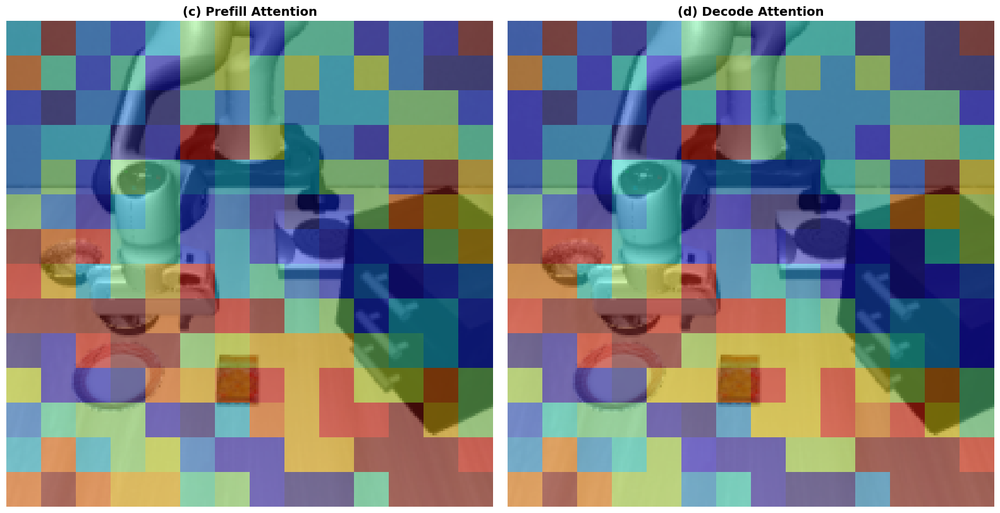

In [5]:
import os
import sys
import time
import math
import tqdm
import imageio
import pathlib
import dataclasses
import collections
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.cm as cm
import cv2
import importlib

from datasets import load_dataset
from openpi.training import config as _config
from openpi.policies import policy_config
from openpi_client import image_tools

sys.path.append("/home/wyz/openpi/third_party/libero")
from libero.libero import benchmark, get_libero_path
from libero.libero.envs import OffScreenRenderEnv

os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["JAX_PLATFORMS"] = "cpu"
os.environ["TORCH_DISABLE_DYNAMO"] = "1"
os.environ["PYTORCH_JIT"] = "0"

# ✅ 强制重新加载 transformers 模块以确保使用最新的代码（包含 ToMe 修改）
print("🔄 Reloading transformers modules to ensure ToMe modifications are loaded...")
modules_to_reload = [
    'transformers.models.paligemma.modeling_paligemma',
    'transformers.models.siglip.modeling_siglip',
]

for module_name in modules_to_reload:
    if module_name in sys.modules:
        del sys.modules[module_name]
        print(f"  ✅ Cleared cache for {module_name}")

# 重新导入以确保使用最新代码
try:
    from transformers import PaliGemmaForConditionalGeneration
    print("  ✅ Successfully reloaded transformers modules")
except Exception as e:
    print(f"  ⚠️ Warning during reload: {e}")

LIBERO_DUMMY_ACTION = [0.0] * 6 + [-1.0]
LIBERO_ENV_RESOLUTION = 256


# ============================================================
# 📊 注意力热力图可视化工具
# ============================================================
# 全局变量存储注意力权重
_attention_weights_prefill = None
_attention_weights_decode = None

def attention_hook_prefill(module, input, output):
    """Hook 函数：捕获 Prefill 阶段的注意力权重"""
    global _attention_weights_prefill
    # GemmaAttention.forward 返回 (attn_output, attn_weights)
    # attn_weights 形状: [B, num_heads, seq_len, seq_len] 或 None
    if isinstance(output, tuple) and len(output) > 1:
        attn_weights = output[1]
        if attn_weights is not None and isinstance(attn_weights, torch.Tensor):
            _attention_weights_prefill = attn_weights
    elif hasattr(output, 'attentions') and output.attentions is not None:
        _attention_weights_prefill = output.attentions

def attention_hook_decode(module, input, output):
    """Hook 函数：捕获 Decode 阶段的注意力权重"""
    global _attention_weights_decode
    if isinstance(output, tuple) and len(output) > 1:
        if isinstance(output[1], torch.Tensor):
            _attention_weights_decode = output[1]
    elif hasattr(output, 'attentions') and output.attentions is not None:
        _attention_weights_decode = output.attentions

def extract_attention_from_llm_layer(
    model,
    vision_embeddings: torch.Tensor,
    text_embeddings: torch.Tensor,
    num_vision_tokens: int,
    layer_idx: int = 0,  # 使用第一层或最后一层
) -> torch.Tensor:
    """
    从 LLM 层提取文本对视觉的真实注意力权重
    
    Args:
        model: PaliGemma 模型
        vision_embeddings: [B, num_vision, D]
        text_embeddings: [B, num_text, D]
        num_vision_tokens: 视觉 token 数量
        layer_idx: 要提取的层索引
    
    Returns:
        attention: [B, num_vision] - 每个视觉 token 的注意力分数
    """
    global _attention_weights_prefill
    
    llm = model.paligemma_with_expert.paligemma.language_model
    
    # 拼接视觉和文本 embeddings
    all_embeddings = torch.cat([vision_embeddings, text_embeddings], dim=1)  # [B, num_vision+num_text, D]
    
    # 获取指定层
    if hasattr(llm, 'layers') and len(llm.layers) > layer_idx:
        target_layer = llm.layers[layer_idx]
        
        # 注册 hook 到注意力层
        if hasattr(target_layer, 'self_attn'):
            hook = target_layer.self_attn.register_forward_hook(attention_hook_prefill)
            
            # 前向传播（只到目标层）
            hidden_states = all_embeddings
            for i, layer in enumerate(llm.layers):
                if i <= layer_idx:
                    hidden_states = layer(hidden_states)[0] if isinstance(layer(hidden_states), tuple) else layer(hidden_states)
                else:
                    break
            
            # 移除 hook
            hook.remove()
            
            # 提取注意力权重
            if _attention_weights_prefill is not None:
                # _attention_weights_prefill 形状: [B, num_heads, seq_len, seq_len]
                attn_weights = _attention_weights_prefill
                
                # 如果是多 head，平均所有 head
                if attn_weights.ndim == 4:
                    attn_weights = attn_weights.mean(dim=1)  # [B, seq_len, seq_len]
                
                # 提取文本对视觉的注意力
                # attn_weights: [B, seq_len, seq_len]
                # 文本 token 位置: num_vision_tokens 到 seq_len
                # 视觉 token 位置: 0 到 num_vision_tokens
                text_to_vision_attn = attn_weights[:, num_vision_tokens:, :num_vision_tokens]  # [B, num_text, num_vision]
                
                # 聚合：平均所有文本 token 的注意力
                vision_attention = text_to_vision_attn.mean(dim=1)  # [B, num_vision]
                
                return vision_attention
    
    # Fallback: 使用余弦相似度
    vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)
    text_norm = F.normalize(text_embeddings, p=2, dim=-1)
    similarity = torch.bmm(vision_norm, text_norm.transpose(1, 2))
    attention = similarity.mean(dim=-1)  # 使用 mean 而不是 max，更平滑
    return attention


def extract_text_vision_attention(
    model,
    vision_embeddings: torch.Tensor,
    text_embeddings: torch.Tensor,
    num_vision_tokens: int,
    layer_idx: int = -1,  # 默认使用最后一层，通常最能体现任务焦点
    use_last_token_only: bool = True,  # 只使用最后一个文本token的注意力
) -> torch.Tensor:
    """
    从真实的Transformer层提取文本对视觉的注意力权重（Prefill阶段）
    
    改进：
    1. 从LLM层的真实attention weights提取，而不是使用余弦相似度
    2. 只取最后一个文本token的注意力（更能体现当前任务焦点）
    
    Args:
        model: PaliGemma模型
        vision_embeddings: [B, num_vision, D]
        text_embeddings: [B, num_text, D]
        num_vision_tokens: 视觉token数量
        layer_idx: 要提取的层索引（-1表示最后一层）
        use_last_token_only: 如果True，只使用最后一个文本token的注意力
    """
    global _attention_weights_prefill
    _attention_weights_prefill = None
    
    try:
        llm = model.paligemma_with_expert.paligemma.language_model
        
        # 拼接视觉和文本embeddings
        all_embeddings = torch.cat([vision_embeddings, text_embeddings], dim=1)  # [B, num_vision+num_text, D]
        
        # 确定层索引（-1表示最后一层）
        if layer_idx < 0:
            layer_idx = len(llm.layers) + layer_idx
        
        if hasattr(llm, 'layers') and len(llm.layers) > layer_idx:
            target_layer = llm.layers[layer_idx]
            
            # 注册hook到注意力层
            if hasattr(target_layer, 'self_attn'):
                hook = target_layer.self_attn.register_forward_hook(attention_hook_prefill)
                
                # 前向传播（只到目标层）
                hidden_states = all_embeddings
                for i, layer in enumerate(llm.layers):
                    if i <= layer_idx:
                        # 需要传递正确的参数
                        # GemmaDecoderLayer.forward 需要 output_attentions=True 来返回注意力权重
                        layer_output = layer(
                            hidden_states,
                            output_attentions=True if i == layer_idx else False,  # 只在目标层提取注意力
                            use_cache=False,
                        )
                        if isinstance(layer_output, tuple):
                            hidden_states = layer_output[0]
                        else:
                            hidden_states = layer_output
                    else:
                        break
                
                # 移除hook
                hook.remove()
                
                # 提取注意力权重
                if _attention_weights_prefill is not None:
                    attn_weights = _attention_weights_prefill
                    
                    # 如果是多head，平均所有head
                    if attn_weights.ndim == 4:
                        attn_weights = attn_weights.mean(dim=1)  # [B, seq_len, seq_len]
                    
                    # 提取文本对视觉的注意力
                    # attn_weights: [B, seq_len, seq_len]
                    # 文本token位置: num_vision_tokens 到 seq_len
                    # 视觉token位置: 0 到 num_vision_tokens
                    text_to_vision_attn = attn_weights[:, num_vision_tokens:, :num_vision_tokens]  # [B, num_text, num_vision]
                    
                    # 聚合：根据use_last_token_only决定使用最后一个token还是平均所有token
                    if use_last_token_only and text_to_vision_attn.shape[1] > 0:
                        # 只取最后一个文本token的注意力（更能体现当前任务焦点）
                        vision_attention = text_to_vision_attn[:, -1, :]  # [B, num_vision]
                    else:
                        # 平均所有文本token的注意力
                        vision_attention = text_to_vision_attn.mean(dim=1)  # [B, num_vision]
                    
                    return vision_attention
    except Exception as e:
        print(f"⚠️ 从Transformer层提取注意力失败，回退到余弦相似度: {e}")
    
    # Fallback: 使用余弦相似度（如果从Transformer层提取失败）
    vision_norm = F.normalize(vision_embeddings, p=2, dim=-1)  # [B, num_vision, D]
    text_norm = F.normalize(text_embeddings, p=2, dim=-1)  # [B, num_text, D]
    
    # 计算相似度矩阵: [B, num_vision, num_text]
    similarity = torch.bmm(vision_norm, text_norm.transpose(1, 2))
    
    # 聚合：如果use_last_token_only，只取最后一个token；否则平均
    if use_last_token_only and similarity.shape[-1] > 0:
        attention = similarity[:, :, -1]  # [B, num_vision] - 只取最后一个文本token
    else:
        attention = similarity.mean(dim=-1)  # [B, num_vision] - 平均所有文本token
    
    return attention


def reshape_attention_to_image(
    attention: torch.Tensor,
    image_size: tuple = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
    power_scale: float = 1.5,  # Power scale增强对比度（论文风格）
    use_nearest_interp: bool = True,  # 使用最近邻插值产生块状效果（论文风格）
) -> np.ndarray:
    """
    将注意力权重重塑为图像空间
    
    改进：
    1. 使用最近邻插值（INTER_NEAREST）产生块状效果，更接近论文风格
    2. 添加power scale归一化，增强对比度，使高亮区域更集中
    """
    if attention.ndim == 2:
        attention = attention[0]  # 取第一个 batch
    
    h, w = image_size
    h_patches = h // patch_size
    w_patches = w // patch_size
    patches_per_image = h_patches * w_patches
    
    # 处理多个图像
    if num_images > 1:
        attention = attention[:patches_per_image]
    
    if len(attention) > patches_per_image:
        attention = attention[:patches_per_image]
    elif len(attention) < patches_per_image:
        padding = patches_per_image - len(attention)
        attention = torch.cat([
            attention,
            torch.zeros(padding, device=attention.device)
        ])
    
    # 转换为 numpy 并重塑（确保 detach 和 no_grad）
    if isinstance(attention, torch.Tensor):
        # 先 detach，转换为 float32（bfloat16 不支持），再移动到 CPU，最后转换为 numpy
        attention = attention.detach().float().cpu().numpy()
    
    # 应用power scale增强对比度（在reshape之前）
    if power_scale != 1.0:
        # 归一化到[0, 1]范围
        attn_min = attention.min()
        attn_max = attention.max()
        if attn_max > attn_min:
            attention_norm = (attention - attn_min) / (attn_max - attn_min + 1e-8)
            # 应用power scale
            attention = attention_norm ** power_scale
            # 恢复原始范围
            attention = attention * (attn_max - attn_min) + attn_min
    
    attention_map = attention.reshape(h_patches, w_patches)
    
    # 上采样到原始图像大小
    # 使用最近邻插值产生块状效果（论文风格），而不是平滑的双线性插值
    interp_method = cv2.INTER_NEAREST if use_nearest_interp else cv2.INTER_LINEAR
    attention_map = cv2.resize(
        attention_map,
        (w, h),
        interpolation=interp_method
    )
    
    return attention_map


def visualize_attention_overlay(
    image: np.ndarray,
    attention_map: np.ndarray,
    title: str = "Attention",
    alpha: float = 0.6,
    cmap: str = 'jet',
    ax=None,
    use_percentile: bool = True,  # 使用百分位数归一化，使对比更明显
    power_scale: float = 1.0,  # 额外的power scale（在reshape之后再次应用）
):
    """
    在图像上叠加注意力热力图
    
    改进：
    1. 降低alpha值（0.4-0.5）减少背景干扰
    2. 支持额外的power scale增强对比度
    
    Args:
        use_percentile: 如果 True，使用百分位数归一化（去除极端值），使注意力更明显
        power_scale: 额外的power scale（在归一化之后应用），增强对比度
    """
    # 归一化注意力图
    if use_percentile:
        # 使用百分位数归一化，去除极端值，使注意力分布更明显
        p5 = np.percentile(attention_map, 5)
        p95 = np.percentile(attention_map, 95)
        attn_norm = (attention_map - p5) / (p95 - p5 + 1e-8)
        attn_norm = np.clip(attn_norm, 0, 1)
    else:
        attn_norm = (attention_map - attention_map.min()) / (attention_map.max() - attention_map.min() + 1e-8)
    
    # 应用额外的power scale增强对比度
    if power_scale != 1.0:
        attn_norm = attn_norm ** power_scale
    
    # 创建颜色映射（使用更鲜艳的颜色方案）
    colored_attention = plt.get_cmap(cmap)(attn_norm)[:, :, :3]
    
    # 叠加（调整混合方式，使注意力更突出）
    if image.dtype == np.uint8:
        image_norm = image.astype(np.float32) / 255.0
    else:
        image_norm = image.astype(np.float32)
    
    # 使用更明显的叠加方式
    overlay = (1 - alpha) * image_norm + alpha * colored_attention
    
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    
    ax.imshow(overlay)
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.axis('off')
    
    return ax


def visualize_prefill_decode_comparison(
    image: np.ndarray,
    prefill_attention: torch.Tensor,
    decode_attention: torch.Tensor,
    image_size: tuple = (224, 224),
    patch_size: int = 16,
    num_images: int = 1,
    alpha: float = 0.6,
    cmap: str = 'jet',
    save_path: str = None,
):
    """
    可视化 Prefill 和 Decode 阶段的注意力对比图（类似论文中的图）
    
    改进：
    - 使用最近邻插值产生块状效果（论文风格）
    - 使用power scale增强对比度
    - Prefill: 使用较低的 alpha (0.4-0.5)，使注意力更分散
    - Decode: 使用较低的 alpha (0.4-0.5)，但通过power scale使注意力更聚焦
    """
    # 重塑注意力到图像空间（使用最近邻插值和power scale）
    prefill_map = reshape_attention_to_image(
        prefill_attention, image_size, patch_size, num_images,
        power_scale=1.2,  # Prefill使用较小的power scale
        use_nearest_interp=True,  # 使用最近邻插值产生块状效果
    )
    decode_map = reshape_attention_to_image(
        decode_attention, image_size, patch_size, num_images,
        power_scale=1.5,  # Decode使用较大的power scale，使注意力更聚焦
        use_nearest_interp=True,  # 使用最近邻插值产生块状效果
    )
    
    # 创建并排对比图
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Prefill Attention - 更分散，使用较低的 alpha
    visualize_attention_overlay(
        image, prefill_map,
        title="(c) Prefill Attention",
        alpha=0.4,  # 降低alpha，减少背景干扰（论文风格）
        cmap=cmap,
        ax=axes[0],
        use_percentile=True,  # 使用百分位数归一化
        power_scale=1.0,  # 不再额外应用power scale
    )
    
    # Decode Attention - 更聚焦，使用较低的 alpha，但通过power scale增强对比度
    visualize_attention_overlay(
        image, decode_map,
        title="(d) Decode Attention",
        alpha=0.4,  # 降低alpha，减少背景干扰（论文风格）
        cmap=cmap,
        ax=axes[1],
        use_percentile=True,  # 使用百分位数归一化
        power_scale=1.0,  # 不再额外应用power scale（已在reshape中应用）
    )
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✅ 保存注意力对比图: {save_path}")
    else:
        plt.show()
    
    plt.close()


# ------------------------------------------------------------
# ✅ 加载策略
# ------------------------------------------------------------
def load_policy():
    print("Loading policy checkpoint ...")
    config = _config.get_config("pi05_libero")
    ckpt = "/home/wyz/openpi/checkpoints/pi05_libero_pytorch.pt"

    def _no_compile(x, *args, **kwargs):
        return x
    torch.compile = _no_compile

    try:
        torch.jit._state.disable()
    except Exception:
        pass

    policy = policy_config.create_trained_policy(config, ckpt, pytorch_device="cuda:0")
    print("✅ Policy loaded:", type(policy))
    if hasattr(policy, "model"):
        print(" → Using model:", policy.model.__class__.__module__)
    return policy


# ------------------------------------------------------------
# ✅ 工具函数
# ------------------------------------------------------------
def _quat2axisangle(quat):
    quat = np.array(quat)
    quat = np.clip(quat, -1.0, 1.0)
    den = np.sqrt(max(1e-6, 1.0 - quat[3] ** 2))
    if math.isclose(den, 0.0):
        return np.zeros(3)
    return (quat[:3] * 2.0 * math.acos(quat[3])) / den


def _get_libero_env(task, resolution, seed):
    task_desc = task.language
    bddl_path = pathlib.Path(get_libero_path("bddl_files")) / task.problem_folder / task.bddl_file
    env_args = {"bddl_file_name": bddl_path, "camera_heights": resolution, "camera_widths": resolution}
    env = OffScreenRenderEnv(**env_args)
    env.seed(seed)
    return env, task_desc


# ------------------------------------------------------------
# ✅ 参数类
# ------------------------------------------------------------
@dataclasses.dataclass
class Args:
    task_suite_name: str = "libero_spatial"
    num_trials_per_task: int = 1       # ✅ 每个任务只跑一次
    num_steps_wait: int = 10
    replan_steps: int = 5
    resize_size: int = 224
    video_out_path: str = "./libero_videos_prune"
    seed: int = 7
    # 注意力可视化相关参数
    visualize_attention: bool = True  # 是否可视化注意力
    attention_save_dir: str = "./attention_heatmaps"  # 注意力图保存目录
    attention_save_freq: int = 1  # 每 N 步保存一次注意力图（1=每步都保存）


# ------------------------------------------------------------
# ✅ 主评估函数
# ------------------------------------------------------------
def eval_libero_prune(args: Args):
    policy = load_policy()
    np.random.seed(args.seed)

    # ----------------------
    print("🔥 Warming up policy (compile + autotune)...")
    dummy_element = {
        "observation/image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/wrist_image": np.zeros((args.resize_size, args.resize_size, 3), dtype=np.uint8),
        "observation/state": np.zeros(8, dtype=np.float32),
        "prompt": "dummy task",
    }
    with torch.inference_mode():
        _ = policy.infer(dummy_element)
    torch.cuda.synchronize()
    print("✅ Warmup done, start evaluation...\n")

    # ----------------------
    benchmark_dict = benchmark.get_benchmark_dict()
    task_suite = benchmark_dict[args.task_suite_name]()
    num_tasks = task_suite.n_tasks

    pathlib.Path(args.video_out_path).mkdir(parents=True, exist_ok=True)
    
    # 创建注意力图保存目录
    if args.visualize_attention:
        pathlib.Path(args.attention_save_dir).mkdir(parents=True, exist_ok=True)
        print(f"📊 注意力可视化已启用，保存目录: {args.attention_save_dir}")

    # 最大步数设定
    if args.task_suite_name == "libero_spatial":
        max_steps = 220
    elif args.task_suite_name == "libero_object":
        max_steps = 280
    elif args.task_suite_name == "libero_goal":
        max_steps = 300
    else:
        max_steps = 400

    total_episodes, total_successes = 0, 0
    total_infer_times = []

    print(f"\n🔹 Running evaluation on suite: {args.task_suite_name} ({num_tasks} tasks)")

    for task_id in tqdm.tqdm(range(num_tasks), desc="Tasks"):
        task = task_suite.get_task(task_id)
        init_states = task_suite.get_task_init_states(task_id)
        init_states = init_states[:args.num_trials_per_task]

        env, desc = _get_libero_env(task, LIBERO_ENV_RESOLUTION, args.seed)
        task_episodes, task_successes = 0, 0
        task_infer_times = []

        for ep in range(args.num_trials_per_task):
            obs = env.set_init_state(init_states[ep])
            env.reset()
            action_plan = collections.deque()
            replay_imgs = []

            # 环境稳定等待
            for _ in range(args.num_steps_wait):
                obs, _, _, _ = env.step(LIBERO_DUMMY_ACTION)

            done = False
            t = 0
            while t < max_steps + args.num_steps_wait:
                try:
                    img = np.ascontiguousarray(obs["agentview_image"][::-1, ::-1])
                    wrist = np.ascontiguousarray(obs["robot0_eye_in_hand_image"][::-1, ::-1])

                    img = image_tools.convert_to_uint8(image_tools.resize_with_pad(img, args.resize_size, args.resize_size))
                    wrist = image_tools.convert_to_uint8(image_tools.resize_with_pad(wrist, args.resize_size, args.resize_size))
                    replay_imgs.append(img)

                    if not action_plan:
                        element = {
                            "observation/image": img,
                            "observation/wrist_image": wrist,
                            "observation/state": np.concatenate(
                                (obs["robot0_eef_pos"], _quat2axisangle(obs["robot0_eef_quat"]), obs["robot0_gripper_qpos"])
                            ),
                            "prompt": str(desc),
                        }

                        # ✅ 提取注意力（在推理之前）
                        prefill_attention = None
                        decode_attention = None
                        if args.visualize_attention and t % args.attention_save_freq == 0:
                            try:
                                # 正确获取模型对象：Policy 使用 _model 属性
                                model = policy._model if hasattr(policy, '_model') else policy
                                
                                # 获取设备：对于 PyTorch 模型，使用 _pytorch_device
                                if hasattr(policy, '_pytorch_device'):
                                    device = torch.device(policy._pytorch_device)
                                elif hasattr(model, 'parameters'):
                                    device = next(model.parameters()).device
                                else:
                                    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
                                
                                # 预处理图像（先移动到设备，再进行操作）
                                img_tensor = torch.from_numpy(img).permute(2, 0, 1).float() / 255.0
                                wrist_tensor = torch.from_numpy(wrist).permute(2, 0, 1).float() / 255.0
                                
                                # 先移动到设备
                                img_tensor = img_tensor.unsqueeze(0).to(device)
                                wrist_tensor = wrist_tensor.unsqueeze(0).to(device)
                                
                                # Resize（在设备上进行）
                                img_tensor = F.interpolate(img_tensor, size=(args.resize_size, args.resize_size), mode='bilinear', align_corners=False)
                                wrist_tensor = F.interpolate(wrist_tensor, size=(args.resize_size, args.resize_size), mode='bilinear', align_corners=False)
                                
                                # SigLIP 归一化（确保 mean 和 std 在同一个设备上）
                                mean = torch.tensor([0.5, 0.5, 0.5], device=device).view(1, 3, 1, 1)
                                std = torch.tensor([0.5, 0.5, 0.5], device=device).view(1, 3, 1, 1)
                                img_tensor = (img_tensor - mean) / std
                                wrist_tensor = (wrist_tensor - mean) / std
                                
                                # 嵌入图像（只使用主视角图像用于可视化）
                                img_emb = model.paligemma_with_expert.embed_image(img_tensor)
                                
                                # 只使用主视角图像的 embeddings 用于可视化
                                vision_embeddings = img_emb  # [B, num_vision, D]
                                
                                # 嵌入文本
                                # 使用 tokenizer 编码 prompt
                                from openpi.models.tokenizer import PaligemmaTokenizer
                                tokenizer = PaligemmaTokenizer(max_len=48)
                                tokens, mask = tokenizer.tokenize(str(desc), state=None)
                                tokens = torch.from_numpy(tokens).unsqueeze(0).to(device)
                                
                                lang_emb = model.paligemma_with_expert.embed_language_tokens(tokens)
                                lang_emb_dim = lang_emb.shape[-1]
                                text_embeddings = lang_emb * math.sqrt(lang_emb_dim)  # [B, num_text, D]
                                
                                # 提取 Prefill 和 Decode 注意力（从真实的Transformer层提取）
                                # 使用 no_grad 确保不需要梯度
                                with torch.no_grad():
                                    num_vision_tokens = vision_embeddings.shape[1]
                                    
                                    # Prefill: 从Transformer层提取文本对视觉的真实注意力权重
                                    # 使用最后一层（layer_idx=-1），只取最后一个文本token的注意力（use_last_token_only=True）
                                    prefill_attention = extract_text_vision_attention(
                                        model.paligemma_with_expert,
                                        vision_embeddings,
                                        text_embeddings,
                                        num_vision_tokens,
                                        layer_idx=-1,  # 使用最后一层，最能体现任务焦点
                                        use_last_token_only=False,  # Prefill使用所有文本token的平均
                                    )  # [B, num_vision]
                                    
                                    # Decode: 只使用最后一个文本token的注意力（更能体现当前任务焦点）
                                    decode_attention = extract_text_vision_attention(
                                        model.paligemma_with_expert,
                                        vision_embeddings,
                                        text_embeddings,
                                        num_vision_tokens,
                                        layer_idx=-1,  # 使用最后一层
                                        use_last_token_only=True,  # Decode只使用最后一个文本token
                                    )  # [B, num_vision]
                                    
                                    # 确保 detach（双重保险）
                                    prefill_attention = prefill_attention.detach()
                                    decode_attention = decode_attention.detach()
                                    
                                    # 不再应用softmax，因为真实的attention weights已经是softmax后的概率分布
                                    # 如果需要增强对比度，会在reshape_attention_to_image中通过power_scale实现
                                
                            except Exception as e:
                                print(f"⚠️ 提取注意力时出错: {e}")
                                import traceback
                                traceback.print_exc()

                        # ✅ 纯推理时间测量
                        with torch.inference_mode():
                            torch.cuda.synchronize()
                            t0 = time.perf_counter()
                            actions = policy.infer(element)["actions"]
                            torch.cuda.synchronize()
                            infer_time = (time.perf_counter() - t0) * 1000
                            task_infer_times.append(infer_time)

                        # ✅ 保存注意力热力图
                        if args.visualize_attention and prefill_attention is not None and decode_attention is not None:
                            try:
                                seg = desc.replace(" ", "_")
                                save_path = pathlib.Path(args.attention_save_dir) / f"task{task_id}_ep{ep}_step{t}_attention.png"
                                
                                # 只可视化主视角图像（agentview）
                                visualize_prefill_decode_comparison(
                                    image=img,
                                    prefill_attention=prefill_attention,
                                    decode_attention=decode_attention,
                                    image_size=(args.resize_size, args.resize_size),
                                    patch_size=16,
                                    num_images=1,  # 只显示第一个图像（agentview）
                                    alpha=0.6,
                                    cmap='jet',
                                    save_path=str(save_path)
                                )
                            except Exception as e:
                                print(f"⚠️ 保存注意力图时出错: {e}")

                        action_plan.extend(actions[: args.replan_steps])

                    action = action_plan.popleft()
                    obs, reward, done, info = env.step(action.tolist())

                    if done:
                        task_successes += 1
                        total_successes += 1
                        break

                    t += 1

                except Exception as e:
                    print(f"[⚠️] Exception in task {task_id}, ep {ep}: {e}")
                    break

            task_episodes += 1
            total_episodes += 1

            tag = "success" if done else "failure"
            seg = desc.replace(" ", "_")
            imageio.mimwrite(
                pathlib.Path(args.video_out_path) / f"rollout_{seg}_{tag}_ep{ep}.mp4",
                [np.asarray(x) for x in replay_imgs],
                fps=10,
            )

        # ===== 每个任务结果 =====
        sr = 100 * task_successes / max(task_episodes, 1)
        total_sr = 100 * total_successes / max(total_episodes, 1)
        avg_infer = np.mean(task_infer_times)
        total_infer_times.extend(task_infer_times)

        print(f"✅ Task {task_id}: {desc}")
        print(f" Success rate: {task_successes}/{task_episodes} = {sr:.1f}%")
        print(f" Avg inference time: {avg_infer:.2f} ms")
        print(f" Overall success: {total_successes}/{total_episodes} = {total_sr:.1f}%\n")

    # ===== 汇总结果 =====
    print("=" * 60)
    print(f"🎯 Final success rate on {args.task_suite_name}: {total_successes}/{total_episodes} = {(100 * total_successes / total_episodes):.2f}%")
    print(f"⚙️ Avg inference time over all tasks: {np.mean(total_infer_times):.2f} ± {np.std(total_infer_times):.2f} ms")
    print("=" * 60)


# ------------------------------------------------------------
# ✅ 运行入口
# ------------------------------------------------------------
if __name__ == "__main__":
    args = Args(task_suite_name="libero_spatial", num_trials_per_task=50)  # ✅ 每个任务只跑一次
    with torch.autocast(device_type='cuda', dtype=torch.bfloat16):
        eval_libero_prune(args)
